# IPSC trajectory mono indep/mono dep

In [430]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis',figsize=[10,10])

In [442]:
# Introduce variables
# Note that this script expects raw data to be in "non-batch-corrected" adata.raw.X. 

# Required: Introduce the path you'd like to save figures or data to 
save_path = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data"

# Required: Name of first object
data2 = "_ys"
# Provide path to obj1 // landscape/training data
Object2 = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A4_V7_YS_integrated_data_singlets_with_raw_counts_for_MS_plotting_20211111_with_obsp.h5ad"
# Provide categorical to join between datasets
cat2 = "cell.labels"

# Required: Name of second object
data1 = "_IPSC"
# Provide path to obj2 // prediction/projection data
Object1 = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/OBJ_IPSC_040322.h5ad"
# Provide categorical to join between datasets
cat1 = 'CellTypeLR'

# Required: LR Model Options
penalty='elasticnet' # can be ["l1","l2","elasticnet"]
#penalty='l2'
sparcity=0.2
max_iter = 200 #Increase if experiencing max iter issues
l1_ratio = 0.5 #If using elasticnet, tis controls the ratio between l1 and l2

# Optional: Batch correction options (this is for correction of eventual combined dataset for data1 and data2)
# If you do not have a batch variable for either data1 or data2, please add a "filler" column in the relevent adata.obs
# for the purposes of batch_correction and batch args below.
# e.g., adata.obs["whatever"] = "something"; batch="whatever"
batch_correction = "Harmony" # Will accept Harmony, BBKNN or False as options
# batch = ['tissue_fetal_id','tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
batch = ['tissue','tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
theta = 5

# Optional: miscellaneous Options.   
subsample_train = False # Samples the training data to the smallest fraction (highly dependent on resolution of input celltype categorical). This corrects for proportional differences between celltype labels of interest in the training data. E.g., training data has 50,000 B cells, 20,000 T cells and 100 HSCs. This function will subsample all training to 100 cells per cell type. 
subsample_prop = False # Give this option a proprtion to subsample to(e.g 0.2), if NA given, will subsample to smallest population
subsample_predict = False
subsample_prop_predict = 0.2
remove_non_high_var = False

train_x = 'X_pca' # Define the resource to train and predict on, PCA, X or UMAP (#if you wish to use gene expression, train_x = 'X')
remove_effect_of_custom_gene_list = 'NA' # "./cell_cycle_genes.csv" #remove a custom list of genes from just the variable genes to compute PCA from. Your .csv should have HGNC gene names in the first column to be read in as a vector, any column name is fine.
use_raw = True # Do you want to use adata.raw.X (recommended)

In [431]:
adata2 = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_only_mac_lineage_LR_predicted.h5ad')
concat = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/V3_IPSC_LR_predicted_QC_outs.h5ad')

In [491]:
adata3 = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/YS_ISPC_combined_normalised_v1_070222.h5ad')

In [443]:
concat.obs.groupby(['CellTypeLR']).apply(len)

CellTypeLR
AdvancedMesoderm                8132
EarlyFibroblasts                5144
EmergentMesoderm                 985
Endoderm                        1370
ErythrocyteLineage               360
Fibroblasts                    34046
HemogenicEndothelium            1417
Macrophages                    26427
MastCells                        468
Megakaryocytes                   886
MesoEcto                        1003
Mono-DCprec                     1921
Monocytes                        833
MyeloidProgenitors               207
NeuralCrest                      568
NeutrophilMyeloidProgenitor     2048
PrimitiveStreak                  941
iPSCs                             64
dtype: int64

In [444]:
adata.obs.groupby(['CellTypeLR']).apply(len)

CellTypeLR
AdvancedMesoderm                6065
EarlyFibroblasts                5133
EmergentMesoderm                 270
Endoderm                        1329
ErythrocyteLineage               359
Fibroblasts                    34058
HemogenicEndothelium             974
Macrophages                    26617
MastCells                        565
Megakaryocytes                   893
MesoEcto                         970
Mono-DCprec                     2362
Monocytes                       1019
MyeloidProgenitors               223
NeuralCrest                      519
NeutrophilMyeloidProgenitor     2116
PrimitiveStreak                  551
iPSCs                              6
dtype: int64

In [445]:
concat

AnnData object with n_obs × n_vars = 86820 × 22386
    obs: 'orig.ident', 'CellTypeLR', 'nCount_RNA', 'nFeature_RNA', 'DEMline', 'DBL_final', 'RAWdf', 'SOCline', 'percent.mt', 'SOClineRAW', 'SampleName', 'CellTypeP', 'DBLdetect', 'DBLscrub', 'DBLdemux', 'DBLsoc', 'DBL_nFINAL', 'S.Score', 'G2M.Score', 'Phase', 'CC.Difference', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.5', 'integrated_snn_res.0.8', 'integrated_snn_res.1', 'integrated_snn_res.3', 'integrated_snn_res.6', 'integrated_snn_res.10', 'seurat_clusters', 'tissue', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'V6_old_indexes', 'tissue_fetal_id', 'batch', 'n_counts', 'LR_assignment', 'restricted_LR_assignment'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable-1', 'intersect-1', 'means-1', 'dispersions-1', 'disp

In [389]:
# Build data with all macs intact including <0.7 LR Macs
adata2 = adata2[adata2.obs['LR_assignment'].isin(['Macrophage_IPSC'])]
adata2 = adata2[~adata2.obs.index.isin(concat.obs.index)]
concat = concat.concatenate(adata2,join='inner',index_unique=None)

In [496]:
adata_raw = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/OBJ_IPSC_230322.h5ad')

In [504]:
adata_raw.write('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/OBJ_IPSC_230322.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'LR_assignment' as categorical


In [497]:
adata3 = adata3[adata3.obs.index.isin(adata_raw.obs.index)]

In [498]:
adata_raw.obs['CellTypeLR'] =  adata3.obs['CellTypeLR']

In [471]:
# adata_raw = adata_raw[adata_raw.obs.index.isin(concat.obs.index)]
# adata_raw.obs = concat.obs

In [499]:
concat.obs

,orig.ident,CellTypeLR,nCount_RNA,nFeature_RNA,DEMline,DBL_final,RAWdf,SOCline,percent.mt,SOClineRAW,...,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,V6_old_indexes,tissue_fetal_id,batch,n_counts,LR_assignment,restricted_LR_assignment
ACAGCCGAGTTAACGA-1,AGGm,PrimitiveStreak,3814,1458,SNG-vass_1,SNG,OLD,SNG-vass_1,0.131096,1,...,NaN,NaN,NaN,NaN,NaN,NaN,0,3812.0,Erythroid_IPSC,Erythroid_IPSC
ACTTTCATCTACCTGC-1,AGGm,PrimitiveStreak,4148,1588,SNG-vass_1,SNG,OLD,SNG-vass_1,4.267117,1,...,NaN,NaN,NaN,NaN,NaN,NaN,0,4148.0,Erythroid_IPSC,Erythroid_IPSC
AGCCTAAGTACAGCAG-1,AGGm,PrimitiveStreak,1315,767,NaN,NaN,NEW,SNG-vass_1,0.152091,1,...,NaN,NaN,NaN,NaN,NaN,NaN,0,1314.0,Erythroid_IPSC,Erythroid_IPSC
ATCATCTAGTGTACGG-1,AGGm,PrimitiveStreak,3573,1316,NaN,NaN,NEW,SNG-vass_1,0.027988,1,...,NaN,NaN,NaN,NaN,NaN,NaN,0,3572.0,Erythroid_IPSC,Erythroid_IPSC
ATCTGCCCATTGGGCC-1,AGGm,PrimitiveStreak,3687,1465,SNG-vass_1,SNG,OLD,SNG-vass_1,0.135612,1,...,NaN,NaN,NaN,NaN,NaN,NaN,0,3685.0,Erythroid_IPSC,Erythroid_IPSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCACAGACAG-20,AGGm,Macrophages,4624,1400,NaN,NaN,NEW,SNG-kolf_2,4.628028,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,4623.0,Macrophage_IPSC,Macrophage_IPSC
TTTACTGGTAGCTGCC-20,AGGm,Macrophages,16277,3058,SNG-kolf_2,SNG,OLD,SNG-kolf_2,7.095902,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,16277.0,Macrophage_IPSC,Macrophage_IPSC
TTTCCTCGTGCGAAAC-20,AGGm,Macrophages,17283,3519,SNG-kolf_2,SNG,OLD,SNG-kolf_2,7.035816,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,17257.0,Macrophage_IPSC,Macrophage_IPSC
TTTGCGCCATCACCCT-20,AGGm,MastCells,3071,1176,NaN,NaN,NEW,SNG-kolf_2,3.126018,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,3070.0,Mast_cell_IPSC,Mast_cell_IPSC


In [500]:
concat.__dict__.keys()

dict_keys(['_is_view', '_adata_ref', '_oidx', '_vidx', 'file', '_X', '_n_obs', '_n_vars', '_obs', '_var', '_uns', '_obsm', '_varm', '_obsp', '_varp', '_raw', '_layers'])

In [501]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/v3_pred_out.csv',index_col=0)
adata_raw.obs['predicted'] = pred_out['predicted']
adata_raw.obs['predicted'] = adata_raw.obs['predicted'].str.replace('_ys','_IPSC')
adata_raw.obs['LR_assignment'] = adata_raw.obs['predicted'][:]
# keep =  [
#  'HSPC_1_IPSC',
#  'Macrophage_IPSC',
#  'HSPC_2_IPSC',
#  'AEC_IPSC',
#  'Promonocyte_IPSC',
#  'MOP_IPSC',
#  'CMP_IPSC',
#  'Monocyte_IPSC',
#  'HE_IPSC',]
# adata = adata_raw[adata_raw.obs['predicted'].isin(keep)]
# # adata = concat[:]
# adata.obs['SampleName'] = adata.obs['SampleName'].astype(str)
# before_mono = [
# # 'Day00iPSC',
# #  'Day01EB',
# #  'Day03EB',
# #  'Day04EB',
#  'Day05Mac',
#  'Day07Mac',
#  'Day09Mac',
#  'Day11Mac',
#  'Day14Mac',
#  'Day16Mac',]
# adata = adata[adata.obs['SampleName'].isin(before_mono)]
# # remove < 5 cells
# count = adata.obs.groupby(['predicted']).apply(len)
# adata = adata[~adata.obs['predicted'].isin(count.index[count<5])]
# adata.obs.groupby(['predicted']).apply(len)

# Monocyte independent

In [505]:
adata = adata_raw[:]

In [507]:
list(adata.obs['LR_assignment'].unique())

['Mesothelium_IPSC',
 'HSPC_2_IPSC',
 'Prolif_Sinusoidal_EC_IPSC',
 'Fibroblast_IPSC',
 'Early_Erythroid_IPSC',
 'Erythroid_IPSC',
 'HSPC_1_IPSC',
 'Immature_EC_IPSC',
 'Macrophage_IPSC',
 'Smooth_Muscle_IPSC',
 'Lymphoid_progenitor_IPSC',
 'MEMP_IPSC',
 'Endoderm_IPSC',
 'AEC_IPSC',
 'HE_IPSC',
 'MK_IPSC',
 'Promonocyte_IPSC',
 'Mast_cell_IPSC',
 'MOP_IPSC',
 'CMP_IPSC',
 'Monocyte_IPSC',
 'Neutrophil_precursor_IPSC',
 'VWF_EC_IPSC',
 'Sinusoidal_EC_IPSC',
 'Eo_Baso_Mast_precursor_IPSC',
 'Cycling DC2_IPSC',
 'Prolif_AEC_IPSC',
 'Pre DC2_IPSC',
 'pDC precursor_IPSC',
 'Monocyte_Macrophage_IPSC',
 'LMPP_IPSC',
 'Mono Mac DC2_IPSC',
 'ILC_precursor_IPSC']

In [463]:
keep =  [
 'HSPC_1_IPSC',
 'Macrophage_IPSC',
 'HSPC_2_IPSC',
 'AEC_IPSC',
 'Promonocyte_IPSC',
 'MOP_IPSC',
 'CMP_IPSC',
# 'Monocyte_IPSC',
 'HE_IPSC',]
adata = adata[adata.obs['LR_assignment'].isin(keep)]

In [484]:
adata.obs.groupby(['LR_assignment']).apply(len)

LR_assignment
AEC_IPSC                         299
CMP_IPSC                        2086
Cycling DC2_IPSC                   1
Early_Erythroid_IPSC            3362
Endoderm_IPSC                   1328
Eo_Baso_Mast_precursor_IPSC       93
Erythroid_IPSC                  3528
Fibroblast_IPSC                36487
HE_IPSC                           24
HSPC_1_IPSC                     2194
HSPC_2_IPSC                     3398
ILC_precursor_IPSC                 1
Immature_EC_IPSC                1348
LMPP_IPSC                          1
Lymphoid_progenitor_IPSC          17
MEMP_IPSC                        101
MK_IPSC                         1071
MOP_IPSC                        3100
Macrophage_IPSC                29438
Mast_cell_IPSC                   750
Mesothelium_IPSC               38057
Mono Mac DC2_IPSC                  3
Monocyte_IPSC                   1008
Monocyte_Macrophage_IPSC           1
Neutrophil_precursor_IPSC        300
Pre DC2_IPSC                       8
Prolif_AEC_IPSC         

In [508]:
adata_raw.obs.groupby(['CellTypeLR']).apply(len)

CellTypeLR
AdvancedMesoderm               12192
EarlyFibroblasts                5654
EmergentMesoderm                4202
Endoderm                        2719
ErythrocyteLineage               367
Fibroblasts                    35697
HemogenicEndothelium            2611
Macrophages                    26769
MastCells                       1207
Megakaryocytes                   963
MesoEcto                        2087
Mono-DCprec                     3773
Monocytes                       1980
MyeloidProgenitors               391
NeuralCrest                     1327
NeutrophilMyeloidProgenitor     4162
PrimitiveStreak                21802
iPSCs                           7864
dtype: int64

In [465]:
batch_correction = "False"

In [509]:
list(adata.obs['SampleName'].unique())

['Day00iPSC',
 'Day01EB',
 'Day03EB',
 'Day04EB',
 'Day05Mac',
 'Day07Mac',
 'Day09Mac',
 'Day11Mac',
 'Day14Mac',
 'Day16Mac',
 'Day18Mac',
 'Day21Mac',
 'Day23Mac',
 'Day25Mac',
 'Day28Mac',
 'Day31Mac',
 'Day31Mpre',
 'Day31plus1Mpre',
 'Day31plus4Mpre',
 'Day31plus7Mpre']

In [510]:
# adata = concat[:]
adata.obs['SampleName'] = adata.obs['SampleName'].astype(str)
before_mono = [
'Day00iPSC',
 'Day01EB',
 'Day03EB',
 'Day04EB',
'Day05Mac',
 'Day07Mac',
 'Day11Mac',
 'Day14Mac',
 'Day18Mac',
 'Day21Mac',
 'Day23Mac',
 'Day25Mac',
 'Day28Mac',
 'Day31Mac',
 'Day31Mpre',
 'Day31plus1Mpre',
 'Day31plus4Mpre',
 'Day31plus7Mpre',
 'Day16Mac',
 'Day09Mac'
]
adata = adata[adata.obs['SampleName'].isin(before_mono)]

Trying to set attribute `.obs` of view, copying.


In [511]:
# remove < 5 cells
count = adata.obs.groupby(['LR_assignment']).apply(len)
adata = adata[~adata.obs['LR_assignment'].isin(count.index[count<5])]

In [512]:
adata.obs.groupby(['LR_assignment']).apply(len)

LR_assignment
AEC_IPSC                         299
CMP_IPSC                        2086
Early_Erythroid_IPSC            3362
Endoderm_IPSC                   1328
Eo_Baso_Mast_precursor_IPSC       93
Erythroid_IPSC                  3528
Fibroblast_IPSC                36487
HE_IPSC                           24
HSPC_1_IPSC                     2194
HSPC_2_IPSC                     3398
Immature_EC_IPSC                1348
Lymphoid_progenitor_IPSC          17
MEMP_IPSC                        101
MK_IPSC                         1071
MOP_IPSC                        3100
Macrophage_IPSC                29438
Mast_cell_IPSC                   750
Mesothelium_IPSC               38057
Monocyte_IPSC                   1008
Neutrophil_precursor_IPSC        300
Pre DC2_IPSC                       8
Prolif_Sinusoidal_EC_IPSC       5610
Promonocyte_IPSC                 914
Sinusoidal_EC_IPSC                46
Smooth_Muscle_IPSC              1186
dtype: int64

In [513]:
batch_correction = "True"
batch_correction = "Harmony"

Custom gene list option is not selected or path is not readbale, proceeding with no variable removal
computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:01:47)


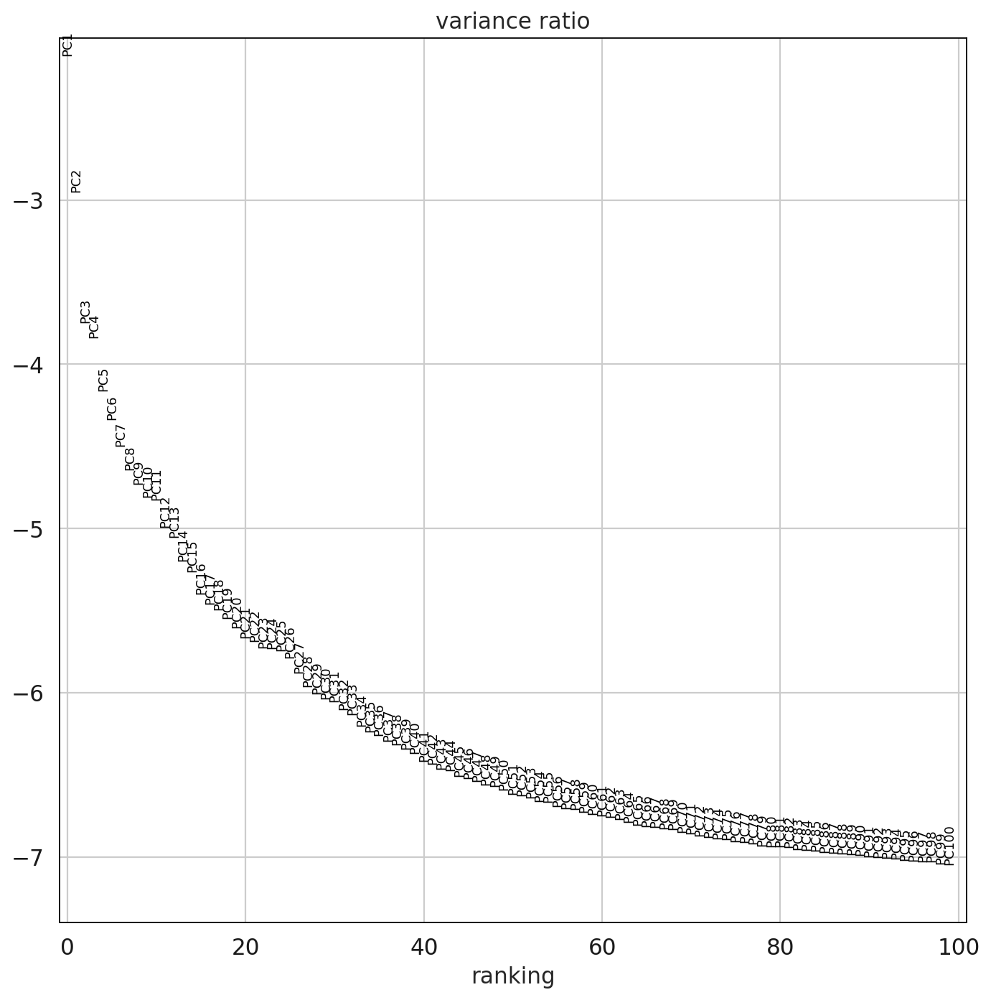

Commencing harmony


2022-03-28 10:48:44,002 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2022-03-28 10:52:50,812 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2022-03-28 10:56:58,732 - harmonypy - INFO - Converged after 2 iterations
INFO:harmonypy:Converged after 2 iterations


computing neighbors
    using 'X_pca' with n_pcs = 75
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:32)
adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!
computing UMAP


Trying to set attribute `.uns` of view, copying.


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:10)


In [516]:
#adata = adata[~adata.obs['predicted'].isin(['Promonocyte_IPSC',])]

# adata.obs['tissue_fetal_id'] = adata.obs['tissue_fetal_id'].astype(str)
adata.obs['tissue_fetal_id'] = 'IPSC'
# adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'tissue_fetal_id'] = 'IPSC'
adata.obs["lr_batch"] = adata.obs['SampleName'][:]

sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.1, max_mean=4)
sc.pp.scale(adata, zero_center=False, max_value=None, copy=False) #zero_center=True (densifies output)

# Optionally remove genes of known confounding effect from variable list
if not (Path(remove_effect_of_custom_gene_list).is_file()):
    print("Custom gene list option is not selected or path is not readbale, proceeding with no variable removal")
else: 
    print("Custom gene removal list detected, proceeding to remove intersect from variable genes")
    regress_list = pd.read_csv(remove_effect_of_custom_gene_list)
    regress_list = regress_list.iloc[:, 0]
    adata.var["highly_variable"][adata.var.index.isin(regress_list)] = "False"


# Now compute PCA
sc.pp.pca(adata, n_comps=100, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

# Batch correction options
# The script will test later which Harmony values we should use
if (batch_correction == "False"):
    sc.pp.neighbors(adata, n_neighbors=30, n_pcs=100)    
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    batch_var = "lr_batch"
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = [batch_var]
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use,theta=theta)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=30, n_pcs=75)
    adata = adata_hm[:]
    del adata_hm
elif(batch_correction == "BBKNN"):
    print("Commencing BBKNN")
    sc.external.pp.bbknn(adata, batch_key=batch_var, approx=True, metric='angular', copy=False, n_pcs=50, trim=None, n_trees=10, use_faiss=True, set_op_mix_ratio=1.0, local_connectivity=15) 
print("adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!")
sc.tl.umap(adata)

In [412]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'SampleName' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'tissue_fetal_id' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprec

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:05)
--> added 'pos', the PAGA positions (adata.uns['paga'])


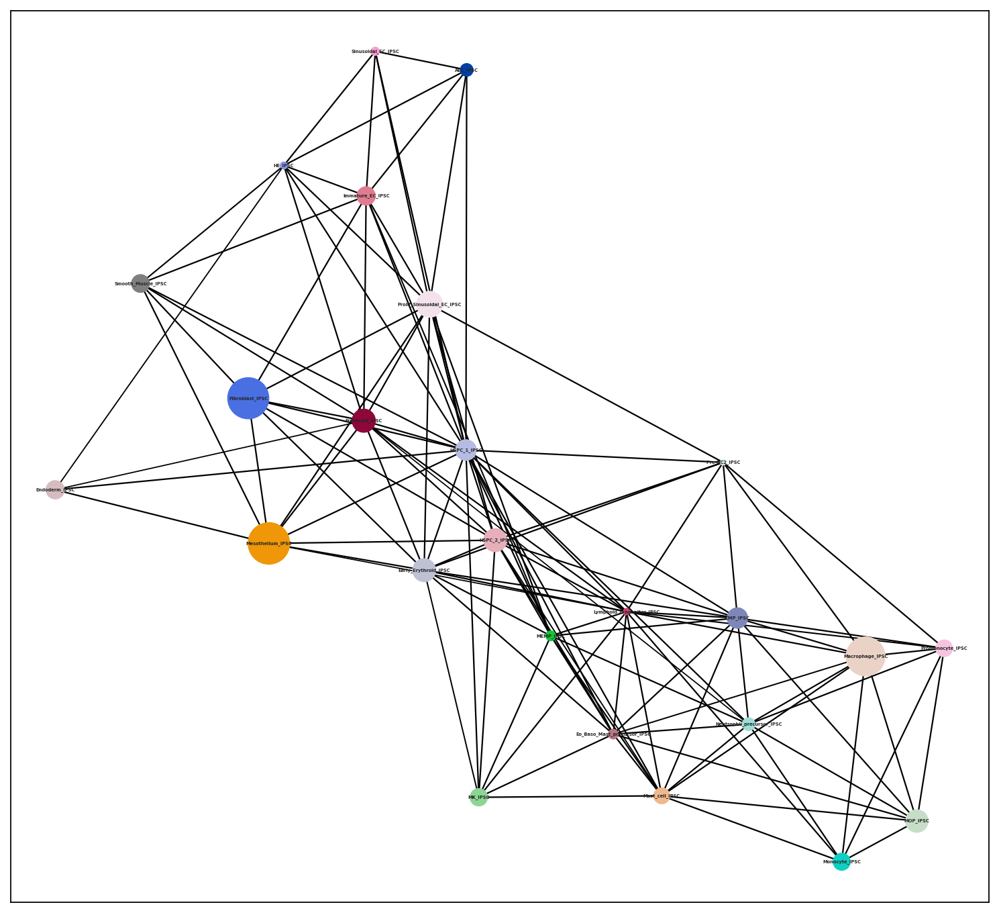

In [517]:
sc.tl.paga(adata, groups='LR_assignment', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
sc.pl.paga(adata, threshold=0.2, color = 'LR_assignment' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')

--> added 'pos', the PAGA positions (adata.uns['paga'])


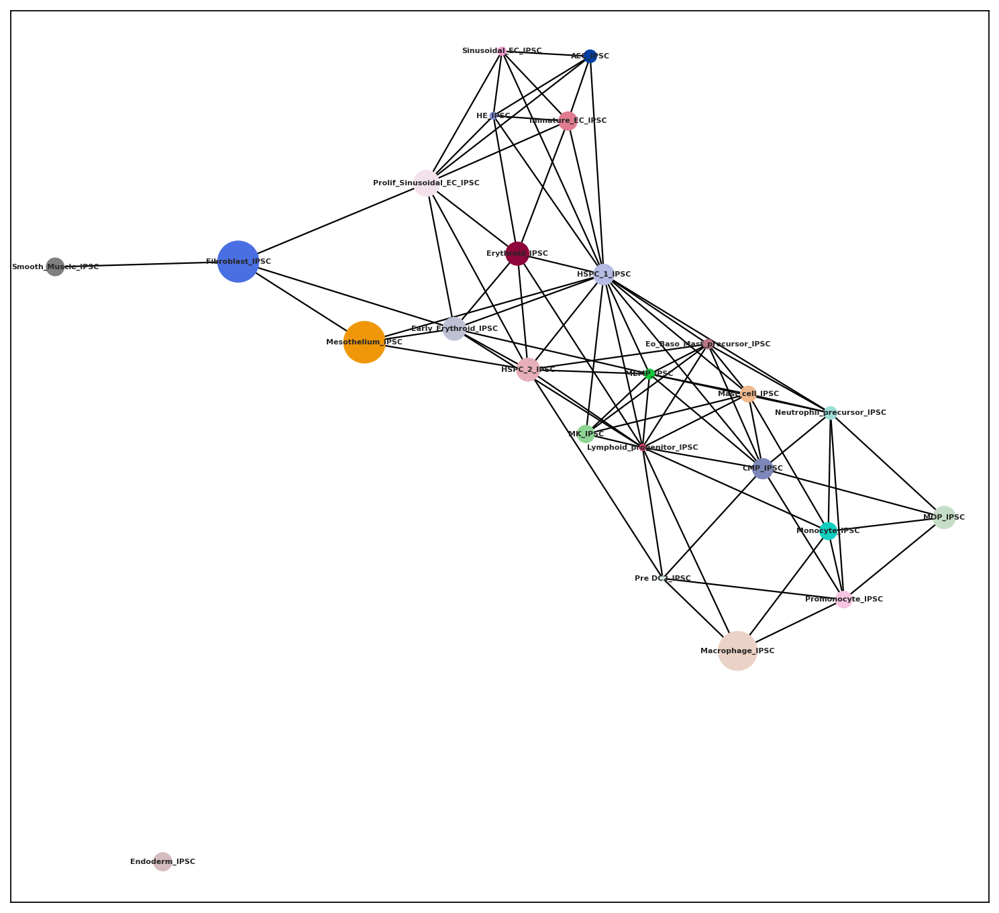

In [518]:
sc.pl.paga(adata, threshold=0.7, color = 'LR_assignment' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=2,fontsize = 5,save='paga_pre_mono')

In [519]:
# connectivities = pd.DataFrame(adata.uns['paga']['connectivities_tree'].toarray(),columns = list(adata.obs['LR_assignment'].cat.categories),index = list(adata.obs['LR_assignment'].cat.categories))

In [520]:
# # Mod
# connectivities = pd.DataFrame(adata.uns['paga']['connectivities'].toarray(),columns = list(adata.obs['LR_assignment'].cat.categories),index = list(adata.obs['LR_assignment'].cat.categories))

# connectivities.loc[connectivities.index.isin(['HE_IPSC']),'CMP_IPSC'] = 0
# connectivities.T.loc[connectivities.index.isin(['HE_IPSC']),'CMP_IPSC'] = 0
# connectivities.loc[connectivities.index.isin(['AEC_IPSC']),'CMP_IPSC'] = 0
# connectivities.loc[connectivities.index.isin(['HE_IPSC']),'Macrophage_IPSC'] = 0
# connectivities.T.loc[connectivities.index.isin(['HE_IPSC']),'Macrophage_IPSC'] = 0
# connectivities.loc[connectivities.index.isin(['AEC_IPSC']),'Macrophage_IPSC'] = 0
# connectivities.T.loc[connectivities.index.isin(['AEC_IPSC']),'Macrophage_IPSC'] = 0
# csr_mat = scipy.sparse.csr_matrix(connectivities.values)

In [521]:
# adata.uns['paga']['connectivities'] = csr_mat
# sc.pl.paga(adata, threshold=0.4, color = 'LR_assignment' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 5,save='paga_pre_mono')

In [522]:
sc.tl.diffmap(adata , n_comps=50, neighbors_key='neighbors', random_state=0, copy=False)
sc.tl.dpt(adata , n_dcs=10, n_branchings=1, min_group_size=0.01, allow_kendall_tau_shift=True, neighbors_key='neighbors', copy=False)
sc.tl.draw_graph(adata)#, #init_pos='paga')

computing Diffusion Maps using n_comps=50(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9962256  0.9959788  0.99220145 0.9910402  0.98990613
     0.9891407  0.98659486 0.98339206 0.98309076 0.9826974  0.9775576
     0.97444344 0.97031826 0.96849936 0.96800745 0.96534115 0.9647121
     0.9626271  0.9608473  0.960411   0.95976436 0.9591538  0.9545738
     0.9529164  0.95149684 0.9504285  0.9483982  0.9478624  0.946316
     0.94505334 0.94462776 0.94360423 0.94304913 0.94250536 0.94109076
     0.94027704 0.9396353  0.93937963 0.9384304  0.9363182  0.9340515
     0.931742   0.9303297  0.9293618  0.9286149  0.9279514  0.92758876
     0.9274902  0.92697525]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:02:18)
    adata.uns['iroot'] = root_cell_index
    adata.var['xroot'] = adata[root_cell_name, :].X
computing Diffusion Pseudotime using n_

In [523]:
adata.obs['predicted'] = adata.obs['LR_assignment'].copy()

In [524]:
cells = adata.obs['predicted'].cat.categories
embed = 'X_draw_graph_fa'
pos = []
for i in cells:
    tmp = adata[adata.obs['predicted'].isin([i])]
    tmp_emded = tmp.obsm[embed]
    # get centroids
    x = [p[0] for p in tmp_emded]
    y = [p[1] for p in tmp_emded]
    centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)

In [525]:
list(adata.obs['predicted'].unique())

['Mesothelium_IPSC',
 'HSPC_2_IPSC',
 'Prolif_Sinusoidal_EC_IPSC',
 'Fibroblast_IPSC',
 'Early_Erythroid_IPSC',
 'Erythroid_IPSC',
 'HSPC_1_IPSC',
 'Immature_EC_IPSC',
 'Macrophage_IPSC',
 'Smooth_Muscle_IPSC',
 'Lymphoid_progenitor_IPSC',
 'MEMP_IPSC',
 'Endoderm_IPSC',
 'AEC_IPSC',
 'HE_IPSC',
 'MK_IPSC',
 'Promonocyte_IPSC',
 'Mast_cell_IPSC',
 'MOP_IPSC',
 'CMP_IPSC',
 'Monocyte_IPSC',
 'Neutrophil_precursor_IPSC',
 'Sinusoidal_EC_IPSC',
 'Eo_Baso_Mast_precursor_IPSC',
 'Pre DC2_IPSC']

<AxesSubplot:xlabel='FA1', ylabel='FA2'>

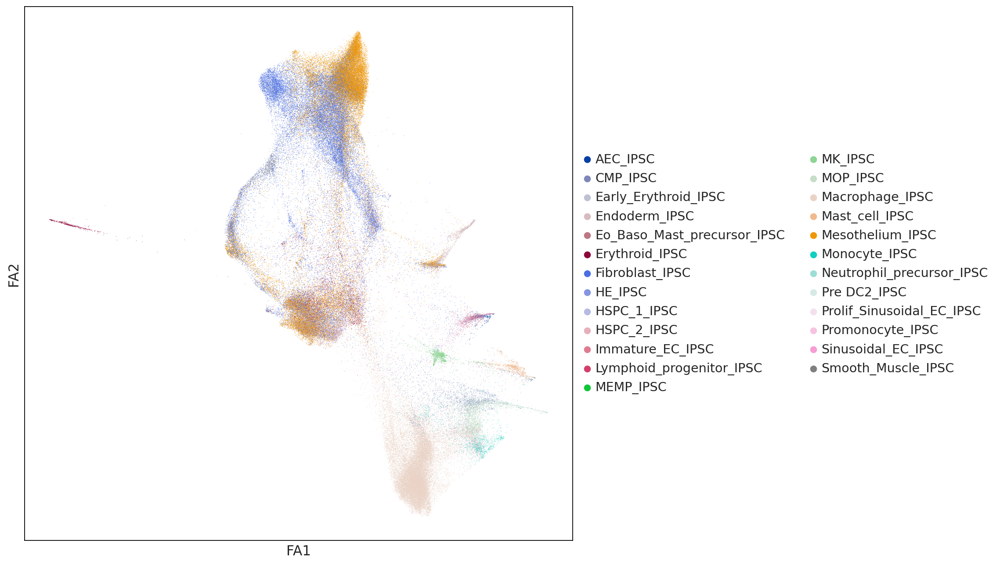

In [526]:
sc.pl.draw_graph(adata, color = 'predicted' ,show=False,title="") #title=i

<AxesSubplot:xlabel='FA1', ylabel='FA2'>

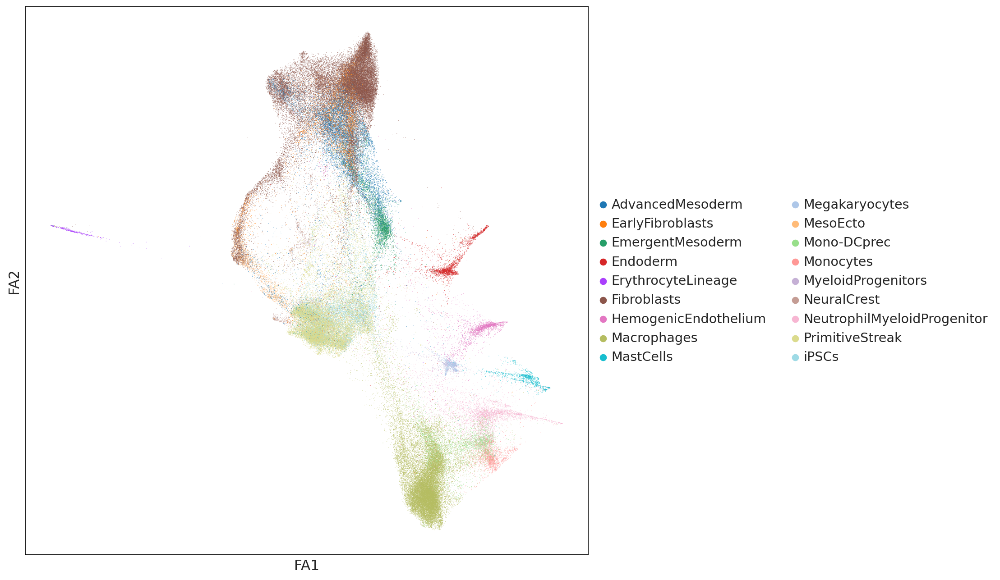

In [530]:
sc.pl.draw_graph(adata, color = 'CellTypeLR' ,show=False,title="") #title=i

<AxesSubplot:xlabel='DC1', ylabel='DC2'>

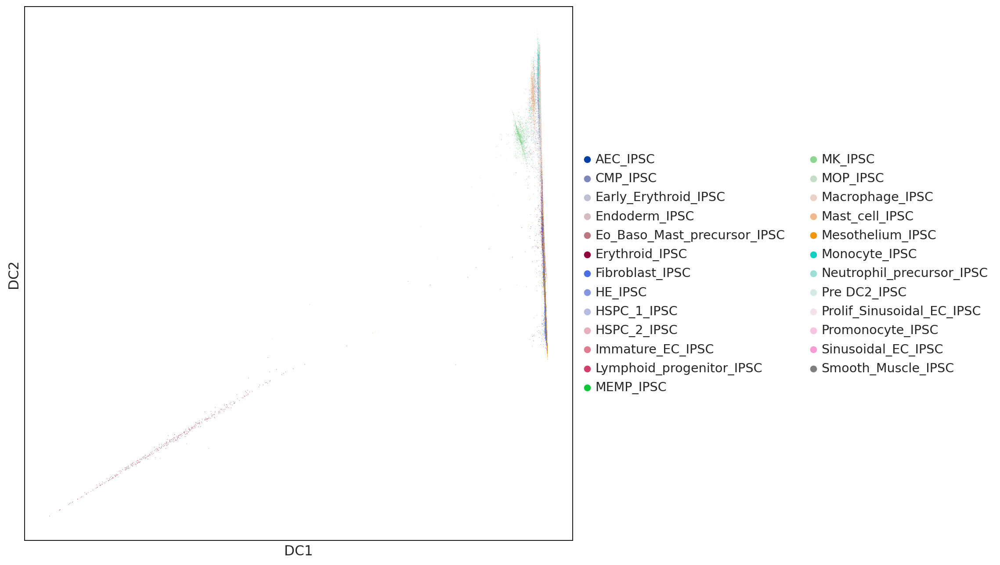

In [528]:
sc.pl.diffmap(adata, color = 'predicted' ,show=False,title="")

In [ ]:
# adata = concat[:]
adata.obs['SampleName'] = adata.obs['SampleName'].astype(str)
before_mono = [
# 'Day00iPSC',
#  'Day01EB',
#  'Day03EB',
#  'Day04EB',
 'Day05Mac',
 'Day07Mac',
 'Day09Mac',
 'Day11Mac',
 'Day14Mac',
 'Day16Mac',
'Day18Mac',
]
adata = adata[adata.obs['SampleName'].isin(before_mono)]

In [421]:
adata.obs['corr_concat'] = adata.obs['predicted'].copy() 
adata.obs['cell.labels'] = adata.obs['predicted'].copy() 

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'corr_concat_num' as categorical


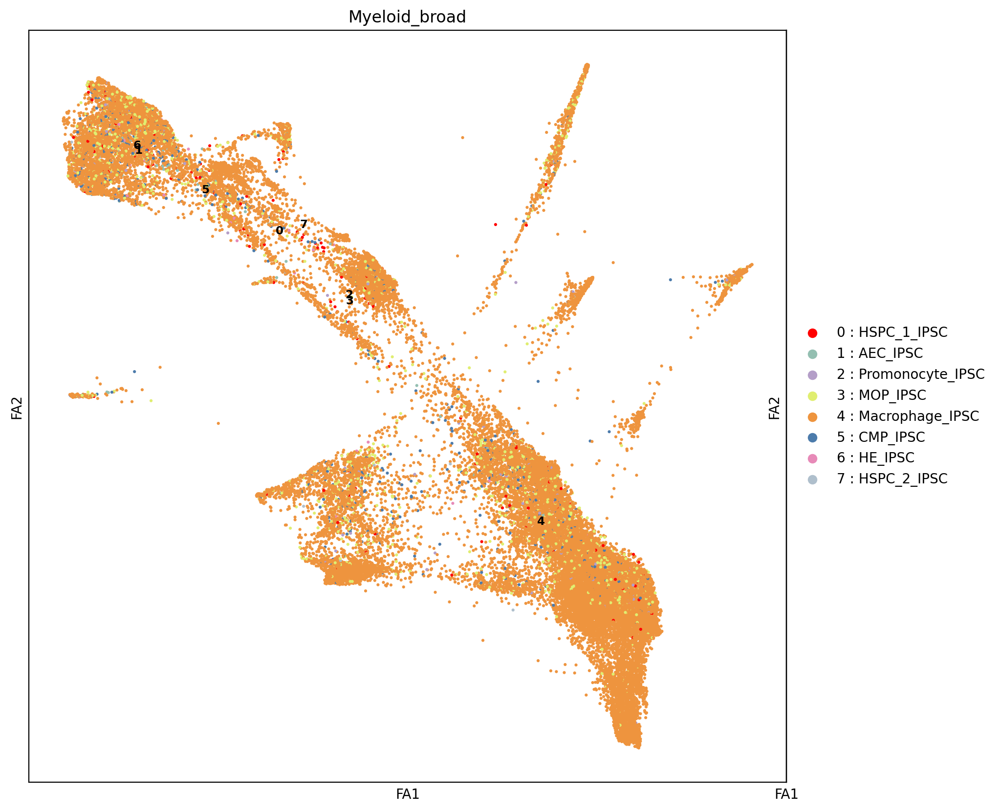

In [422]:
var = "corr_concat"
#Create color dictionary
cells =  (list(adata.obs['corr_concat'][adata.obs['tissue'].isin(['IPSC'])].unique()))
col = list(range(0, len(adata.obs[var].unique())))
#col = adata.uns['cell.labels_colors']
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

col_pal = ['#ff0000',    '#94BFB1',    '#B49EC8',    '#E0EE70',    '#EE943E',    '#4C7BAB',    '#E78AB8',    '#AFBFCC',    '#FF993F',    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
p3 = sc.pl.draw_graph(adata, color = "num",legend_loc="on data",size=20,legend_fontsize='small',ax=ax1,show=False,title="Myeloid_broad", palette= col_pal) #title=i

fig.savefig('./'+var+"_IPSC_pre_mono_num.pdf",bbox_inches='tight')

In [69]:
mapper = {
'HemogenicEndothelium_IPSC':'#eb2a0a',
'CMP': '#3B77AF',
'HSPC_1_MP_IPSC': '#ED8536',
 'HSPC_2_MP_IPSC': '#529B6C',
 'MOP_IPSC': '#C33932',
 'Macrophage_IPSC': '#9B50F3',
 'Monocyte_IPSC': '#D688C3',
 'Monocyte_Macrophage_IPSC': '#B7BC6D',
 'Pre_Macrophage_IPSC': '#5BBCCC',
 'Promonocyte_IPSC': '#B7CAE6'}

In [70]:
#adata = adata[~adata.obs['predicted'].isin(['HemogenicEndothelium_IPSC',])]

In [71]:
adata.obs[var].astype(str).map(mapper)

ATCATCTCACCAACCG-6     #eb2a0a
GATCGTACAACAACCT-6     #529B6C
GGAATAAAGTGGCACA-6     #eb2a0a
AACCATGCATTACGAC-7     #eb2a0a
ACTGCTCTCCGTAGTA-7     #eb2a0a
                        ...   
TTGGCAAGTGCCTGTG-12    #C33932
TTTATGCCAGGTGCCT-12    #eb2a0a
TTTGCGCGTTCCGGCA-12    #eb2a0a
TTTGGTTAGTCCATAC-12    #ED8536
TTTGTCATCCACTCCA-12    #C33932
Name: corr_concat, Length: 1585, dtype: object

In [72]:
adata.obs[var].unique()

['HemogenicEndothelium_IPSC', 'HSPC_2_MP_IPSC', 'HSPC_1_MP_IPSC', 'MOP_IPSC', 'Macrophage_IPSC']
Categories (5, object): ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'MOP_IPSC', 'Macrophage_IPSC']

In [86]:
adata.uns['corr_concat_colors']

['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

In [91]:
adata.obs['corr_concat'].categories = ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC',
       'MOP_IPSC', 'Macrophage_IPSC']
adata.uns['corr_concat_colors'] = ['#ED8536','#529B6C','#eb2a0a','#C33932','#9B50F3',]

adata.obs['predicted'].categories = ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC',
       'MOP_IPSC', 'Macrophage_IPSC']
adata.uns['predicted_colors'] = ['#ED8536','#529B6C','#eb2a0a','#C33932','#9B50F3',]

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'col' as categorical


running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


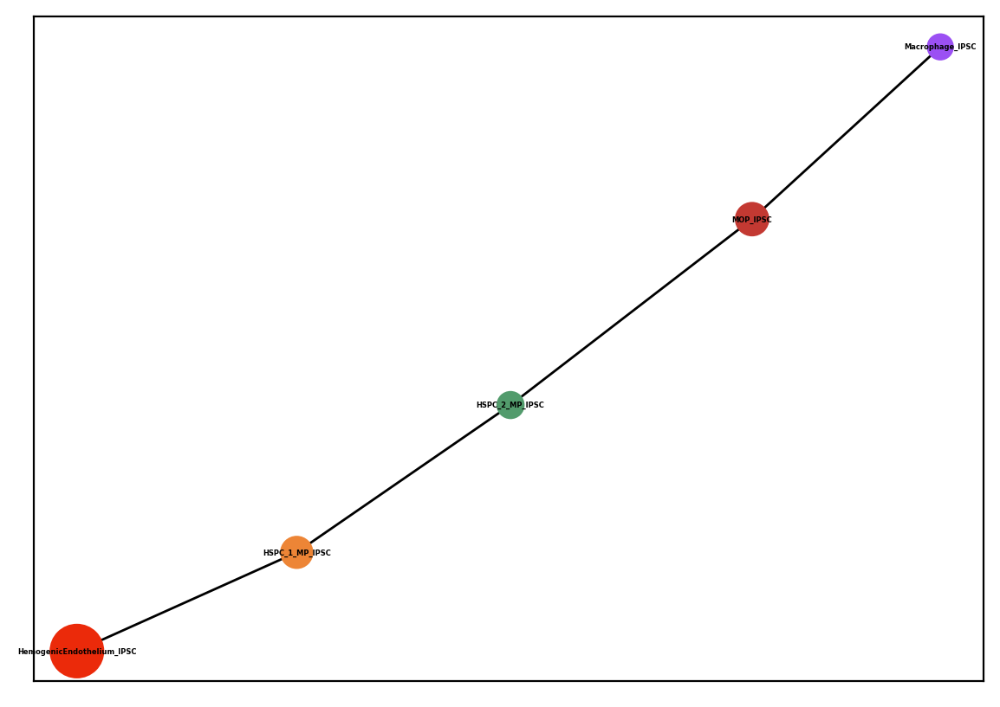

In [92]:
sc.tl.paga(adata, groups='predicted', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
#sc.pl.paga(adata, threshold=0.2, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')
sc.pl.paga(adata, threshold=0.5, color = 'predicted' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')

In [60]:
cells = adata.obs['predicted'].cat.categories
embed = 'X_draw_graph_fa'
pos = []
for i in cells:
    tmp = adata[adata.obs['predicted'].isin([i])]
    tmp_emded = tmp.obsm[embed]
    # get centroids
    x = [p[0] for p in tmp_emded]
    y = [p[1] for p in tmp_emded]
    centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)

Trying to set attribute `.uns` of view, copying.


--> added 'pos', the PAGA positions (adata.uns['paga'])


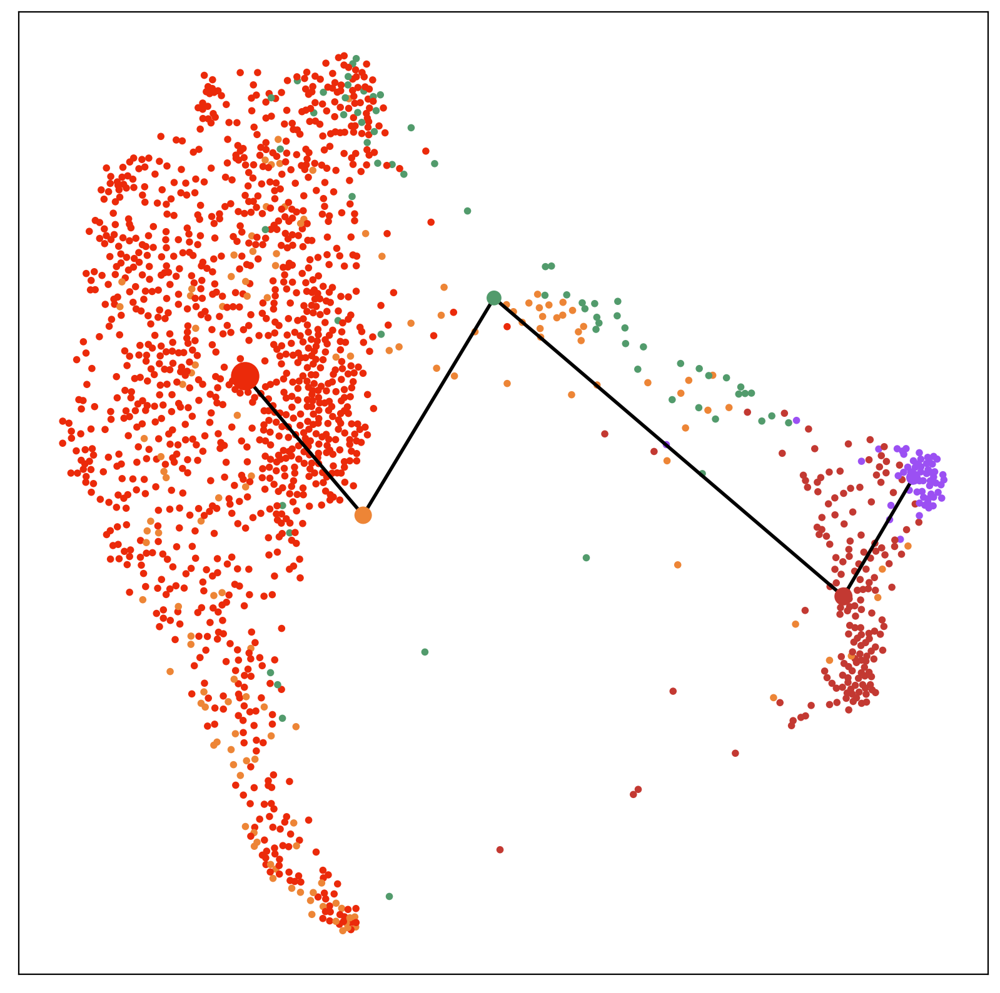

HSPC_1_MP_IPSC
HSPC_2_MP_IPSC
HemogenicEndothelium_IPSC
MOP_IPSC
Macrophage_IPSC


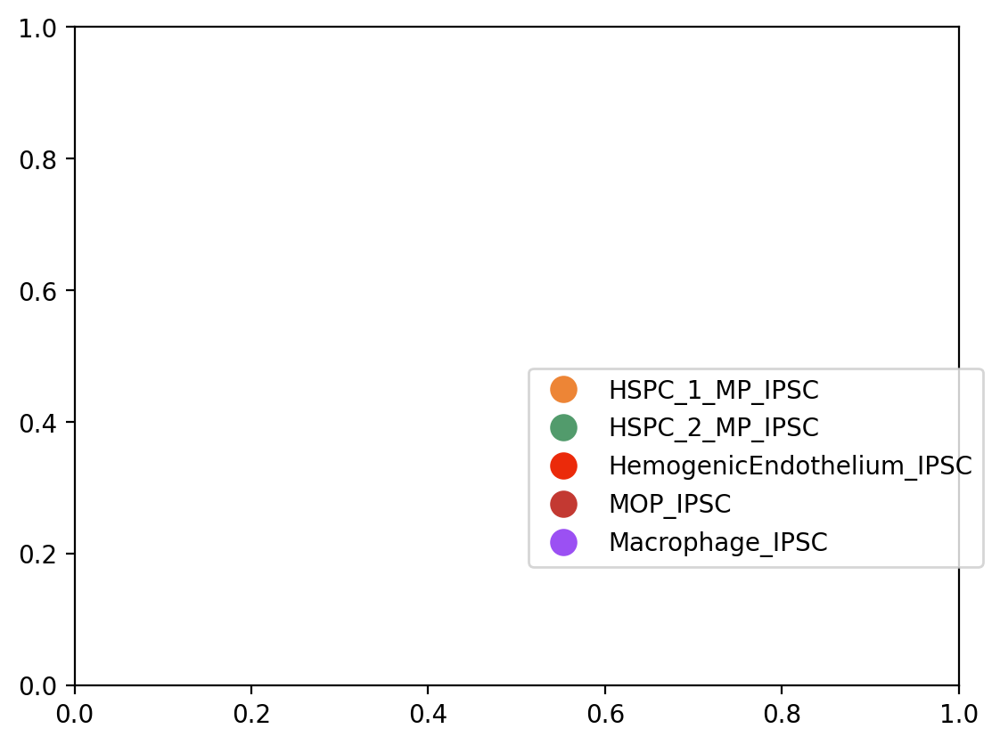

In [94]:
fig, ax = plt.subplots(1,figsize=(10,10))

var = 'predicted'
mapper = mapper #dict(zip(list(adata.obs[var].cat.categories),list(adata.uns[var+'_colors'])))
adata.obs['col'] = adata.obs[var].astype(str).map(mapper)
ax.scatter(adata.obsm['X_draw_graph_fa'][:,0], adata.obsm['X_draw_graph_fa'][:,1],c=adata.obs['col'],s=10)
#sc.pl.paga(adata, threshold=0, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono',ax=ax)
sc.pl.paga(adata, threshold=0.5 , title='',edge_width_scale=0.5,max_edge_width=2 ,pos = adata.uns['paga']['pos'],fontsize=0 ,fontoutline=0 ,  text_kwds={'alpha':0},labels = None,fontweight='bold',save = 'HE_paga',node_size_scale= 0.5,ax=ax)
# sc.pl.draw_graph(adata,color = var,ax=ax)
# ax.set_zorder(-1)
#Make legends

# box = ax.get_position()
# ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

import matplotlib.lines as mlines
legends = []
for legend in adata.obs[var].cat.categories:
    print(legend)
    legends.append(mlines.Line2D([], [], color=mapper[legend], marker='o', linestyle='None',
                          markersize=10, label=legend))
ax.grid(False)
plt.grid(False)
plt.legend(handles=legends,loc="upper left",bbox_to_anchor=(0.5, 0.5))
plt.savefig("./figures/legends_IPSC_paga_overlay_v2.pdf")
fig.savefig("./figures/IPSC_paga_overlay_v2", dpi=300,bbox_inches='tight')

In [96]:
adata.write('./IPSC_MAC_no_mono.h5ad')

In [77]:
obj_path_dic ={'A1_V3_ys_integrated': '/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A2_V1_010721_YS_main.h5ad'
              }

In [ ]:
conda activate workhorse
cd /nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/
cellxgene launch /nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_MAC_no_mono.h5ad --port 5011 --host 0.0.0.0

In [58]:
new_annotations = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IG_bm-cell-labels-ZXGIT772.csv',
                         comment='#',
                         dtype='category',
                         index_col=0)
adata.obs = adata.obs.join(new_annotations)

In [59]:
adata = adata[~adata.obs['keep'].isin(['keep'])]

computing density on 'umap'


Trying to set attribute `.obs` of view, copying.


--> added
    'umap_density_cell.labels', densities (adata.obs)
    'umap_density_cell.labels_params', parameter (adata.uns)


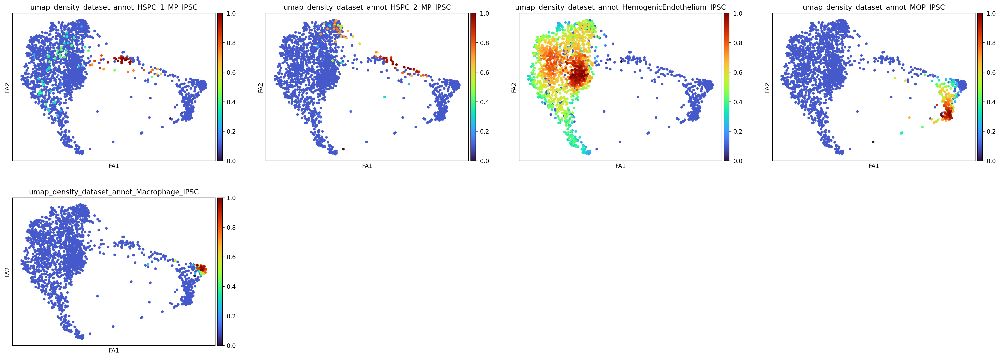

In [99]:
# cells = adata.obs['cell.labels'].cat.categories
# embed = 'X_draw_graph_fa'
# pos = []
# for i in cells:
#     tmp = adata[adata.obs['cell.labels'].isin([i])]
#     tmp_emded = tmp.obsm[embed]
#     # get centroids
#     x = [p[0] for p in tmp_emded]
#     y = [p[1] for p in tmp_emded]
#     centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
#     pos.append(centroid)
    
# adata_post_mono.uns['paga-back'] = adata_post_mono.uns['paga'].copy()
# adata_post_mono.uns['paga']['pos']= np.array(pos)


# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='cell.labels')
pos = []
map_scores = []
for i in adata.obs['cell.labels'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_cell.labels']
    adata.obs.loc[~adata.obs['cell.labels'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
    
#sc.pl.umap(adata,color = 'umap_density_dataset_annot',color_map = 'turbo')
#sc.pl.embedding_density(adata, groupby='dataset_annot',color_map = 'seismic')
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None)

--> added 'pos', the PAGA positions (adata.uns['paga'])


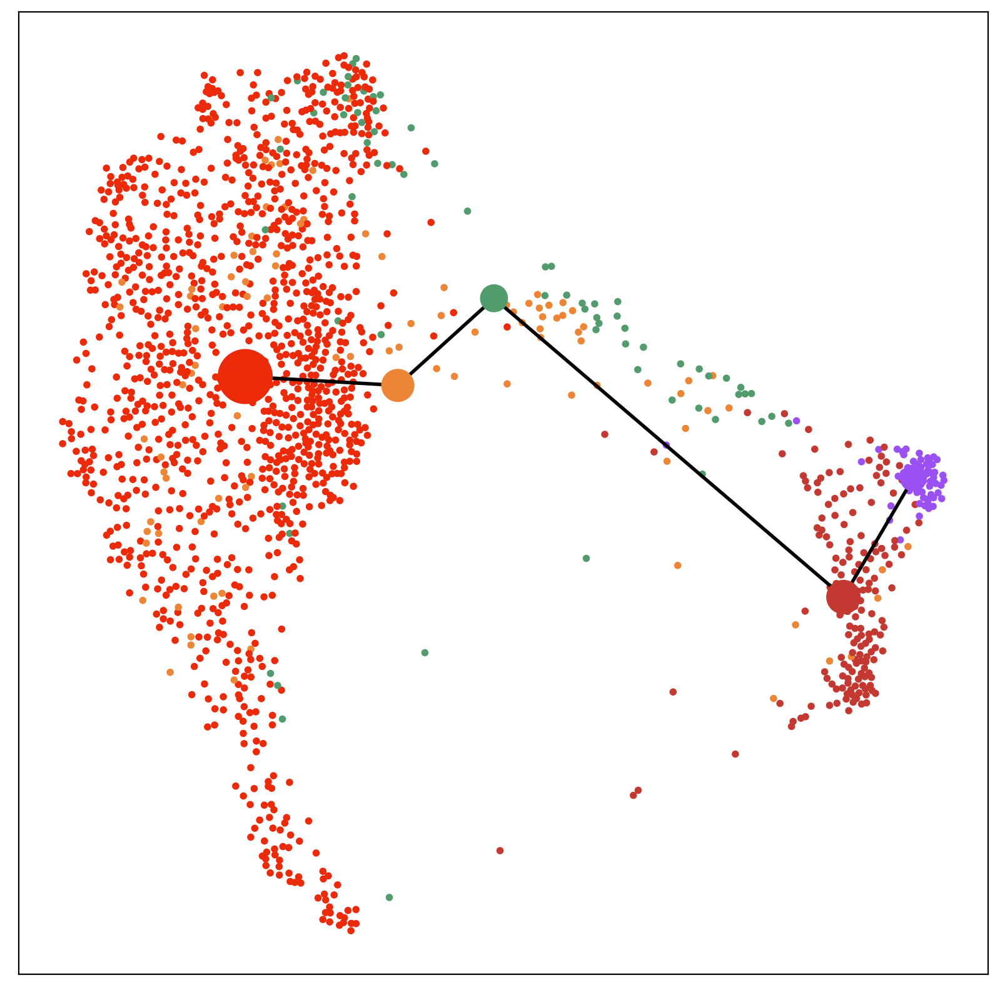

HSPC_1_MP_IPSC
HSPC_2_MP_IPSC
HemogenicEndothelium_IPSC
MOP_IPSC
Macrophage_IPSC


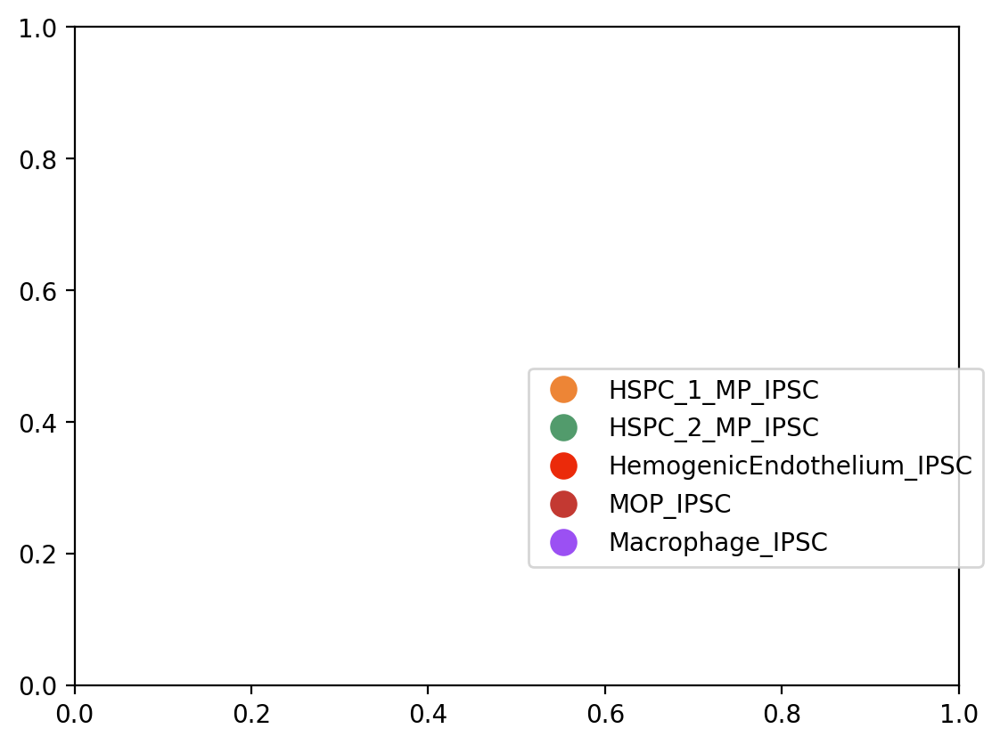

In [61]:
fig, ax = plt.subplots(1,figsize=(10,10))

var = 'corr_concat'
mapper = dict(zip(list(adata.obs[var].cat.categories),list(adata.uns[var+'_colors'])))
adata.obs['col'] = adata.obs[var].astype(str).map(mapper)
ax.scatter(adata.obsm['X_draw_graph_fa'][:,0], adata.obsm['X_draw_graph_fa'][:,1],c=adata.obs['col'],s=10)
#sc.pl.paga(adata, threshold=0, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono',ax=ax)
sc.pl.paga(adata, threshold=0.5 , title='',edge_width_scale=0.5,max_edge_width=2 ,pos = adata.uns['paga']['pos'],fontsize=0 ,fontoutline=0 ,  text_kwds={'alpha':0},labels = None,fontweight='bold',save = 'HE_paga',node_size_scale= 2,ax=ax)
# sc.pl.draw_graph(adata,color = var,ax=ax)
# ax.set_zorder(-1)
#Make legends

# box = ax.get_position()
# ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

import matplotlib.lines as mlines
legends = []
for legend in adata.obs[var].cat.categories:
    print(legend)
    legends.append(mlines.Line2D([], [], color=mapper[legend], marker='o', linestyle='None',
                          markersize=10, label=legend))
ax.grid(False)
plt.grid(False)
plt.legend(handles=legends,loc="upper left",bbox_to_anchor=(0.5, 0.5))
plt.savefig("./figures/legends_IPSC_mono_independen_upto_D21_overlay_v2.pdf")
fig.savefig("./figures/IPSC_mono_independent_upto_D21_paga_overlay_v2.pdf", dpi=300,bbox_inches='tight')

In [56]:
adata=sc.read('./IPSC_MAC_no_mono.h5ad')

computing density on 'umap'
--> added
    'umap_density_SampleName', densities (adata.obs)
    'umap_density_SampleName_params', parameter (adata.uns)


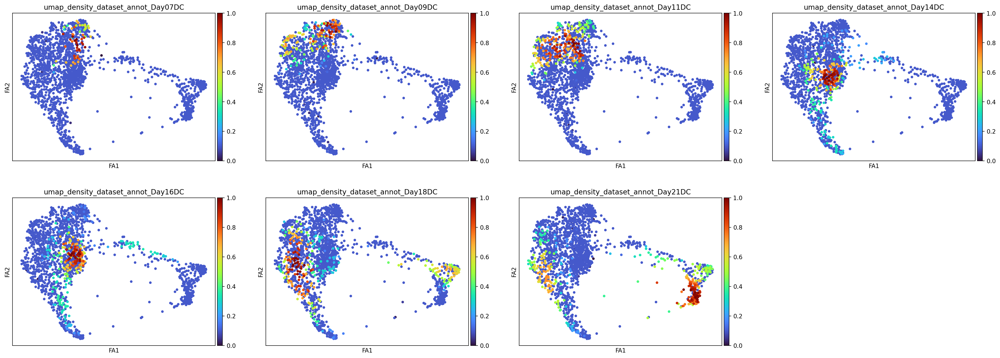

In [256]:
# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='SampleName')
pos = []
map_scores = []
for i in adata.obs['SampleName'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_SampleName']
    adata.obs.loc[~adata.obs['SampleName'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None,save = 'mono_independent_sample_time.pdf')

# Monocyte Dependent

In [125]:
batch_correction = "Harmony"

In [126]:
list(concat.obs['SampleName'].unique())

['Day04EB',
 'Day07DC',
 'Day09DC',
 'Day11DC',
 'Day14DC',
 'Day16DC',
 'Day18DC',
 'Day21DC',
 'Day23DC',
 'Day28DC',
 'Day31DC',
 'Day31plus1DCpre',
 'Day31plus4DCpre',
 'Day31plus7DCpre',
 'Day25DC',
 'Day02EB',
 'Day05DC']

In [208]:
adata_new = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_mac_lin_HE_090322.h5ad')

In [209]:
before_mono = [
 'Day23DC',
 'Day28DC',
 'Day31DC',
 'Day31plus1DCpre',
 'Day31plus4DCpre',
 'Day31plus7DCpre',
 'Day25DC',
 'Day02EB',
 'Day05DC']

adata_new = adata_new[adata_new.obs['SampleName'].isin(before_mono)]

In [210]:
adata_new.obs['predicted'] = adata.obs['predicted'][adata.obs.index.isin(adata_new.obs.index)]
adata_new.obs['corr_concat'] = adata_new.obs['predicted']
#sc.pp.neighbors(adata_new, n_neighbors=30, n_pcs=75)
adata_new = adata_new[adata_new.obs['predicted'].isin(['HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'HSPC_1_MP_IPSC', 'MOP_IPSC', 'Monocyte_IPSC', 'Macrophage_IPSC', 'Monocyte_Macrophage_IPSC'])]

Trying to set attribute `.obs` of view, copying.
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/views.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  container[idx] = value


running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


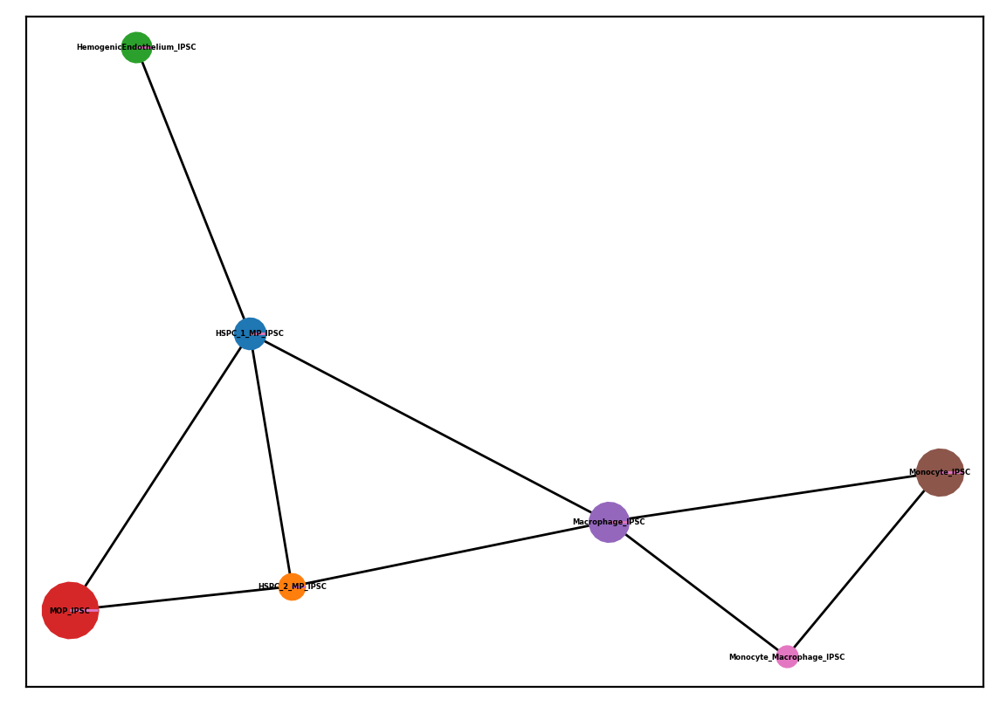

In [215]:
sc.tl.paga(adata_new, groups='predicted', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
sc.pl.paga(adata_new, threshold=0.27, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')

<AxesSubplot:xlabel='FA1', ylabel='FA2'>

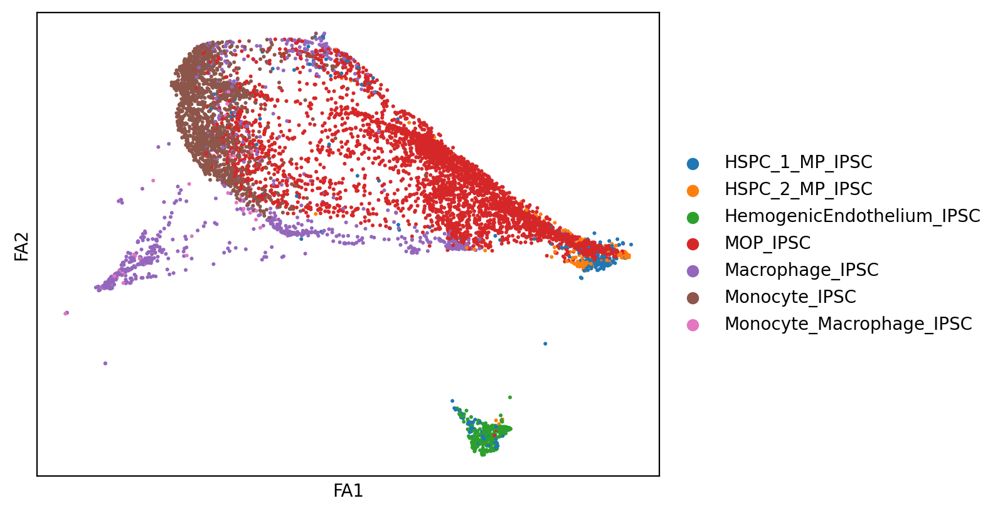

In [216]:
sc.pl.draw_graph(adata_new, color = 'predicted' ,show=False,title="") #title=i

In [219]:
adata = adata[adata.obs.index.isin(adata_new.obs.index)]

In [221]:
adata.obsm['X_draw_graph_fa'] = adata_new.obsm['X_draw_graph_fa']

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Custom gene list option is not selected or path is not readbale, proceeding with no variable removal
computing PCA
    with n_comps=100
    finished (0:01:43)


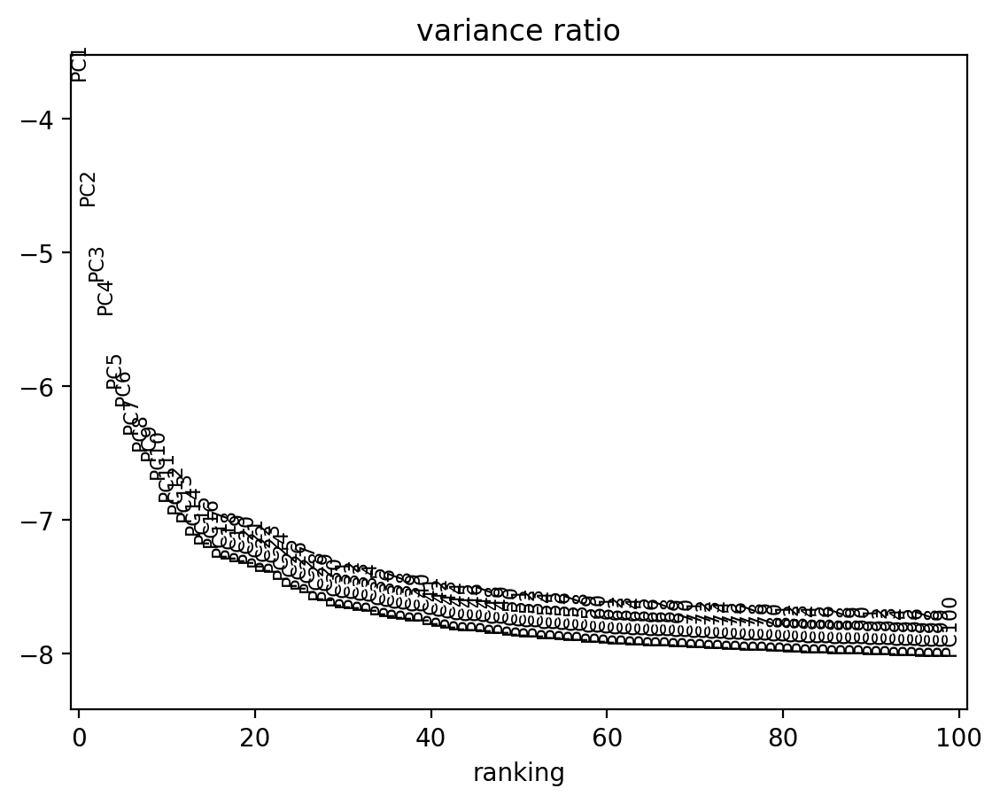

Commencing harmony


2022-03-11 17:01:53,004 - harmonypy - INFO - Iteration 1 of 10
2022-03-11 17:02:03,731 - harmonypy - INFO - Iteration 2 of 10
2022-03-11 17:02:13,220 - harmonypy - INFO - Iteration 3 of 10
2022-03-11 17:02:22,517 - harmonypy - INFO - Iteration 4 of 10
2022-03-11 17:02:31,517 - harmonypy - INFO - Iteration 5 of 10
2022-03-11 17:02:38,415 - harmonypy - INFO - Iteration 6 of 10
2022-03-11 17:02:43,813 - harmonypy - INFO - Iteration 7 of 10
2022-03-11 17:02:48,006 - harmonypy - INFO - Iteration 8 of 10
2022-03-11 17:02:56,503 - harmonypy - INFO - Iteration 9 of 10
2022-03-11 17:03:05,830 - harmonypy - INFO - Iteration 10 of 10
2022-03-11 17:03:12,415 - harmonypy - INFO - Stopped before convergence


computing neighbors
    using 'X_pca' with n_pcs = 75
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)
adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!
computing UMAP


Trying to set attribute `.uns` of view, copying.


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)


In [153]:
adata = concat[:]
adata.obs['SampleName'] = adata.obs['SampleName'].astype(str)

before_mono = [
 'Day23DC',
 'Day28DC',
 'Day31DC',
 'Day31plus1DCpre',
 'Day31plus4DCpre',
 'Day31plus7DCpre',
 'Day25DC',
 'Day02EB',
 'Day05DC']

adata = adata[adata.obs['SampleName'].isin(before_mono)]

adata = adata[~adata.obs['predicted'].isin(['Promonocyte_IPSC',])]


adata.obs['tissue_fetal_id'] = adata.obs['tissue_fetal_id'].astype(str)
adata.obs.loc[adata.obs['tissue'].isin(['IPSC']),'tissue_fetal_id'] = 'IPSC'
adata.obs["lr_batch"] = adata.obs['SampleName'][:]

sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.1, max_mean=4)
sc.pp.scale(adata, zero_center=False, max_value=None, copy=False) #zero_center=True (densifies output)

# Optionally remove genes of known confounding effect from variable list
if not (Path(remove_effect_of_custom_gene_list).is_file()):
    print("Custom gene list option is not selected or path is not readbale, proceeding with no variable removal")
else: 
    print("Custom gene removal list detected, proceeding to remove intersect from variable genes")
    regress_list = pd.read_csv(remove_effect_of_custom_gene_list)
    regress_list = regress_list.iloc[:, 0]
    adata.var["highly_variable"][adata.var.index.isin(regress_list)] = "False"


# Now compute PCA
sc.pp.pca(adata, n_comps=100, use_highly_variable=False, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

# Batch correction options
# The script will test later which Harmony values we should use
if (batch_correction == "False"):
    sc.pp.neighbors(adata, n_neighbors=30, n_pcs=100)    
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    batch_var = "lr_batch"
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = [batch_var]
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use,theta=theta)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=30, n_pcs=75)
    adata = adata_hm[:]
    del adata_hm
elif(batch_correction == "BBKNN"):
    print("Commencing BBKNN")
    sc.external.pp.bbknn(adata, batch_key=batch_var, approx=True, metric='angular', copy=False, n_pcs=50, trim=None, n_trees=10, use_faiss=True, set_op_mix_ratio=1.0, local_connectivity=15) 
print("adata1 and adata2 are now combined and preprocessed in 'adata' obj - success!")
sc.tl.umap(adata)

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'SampleName' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'lr_batch' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated an

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


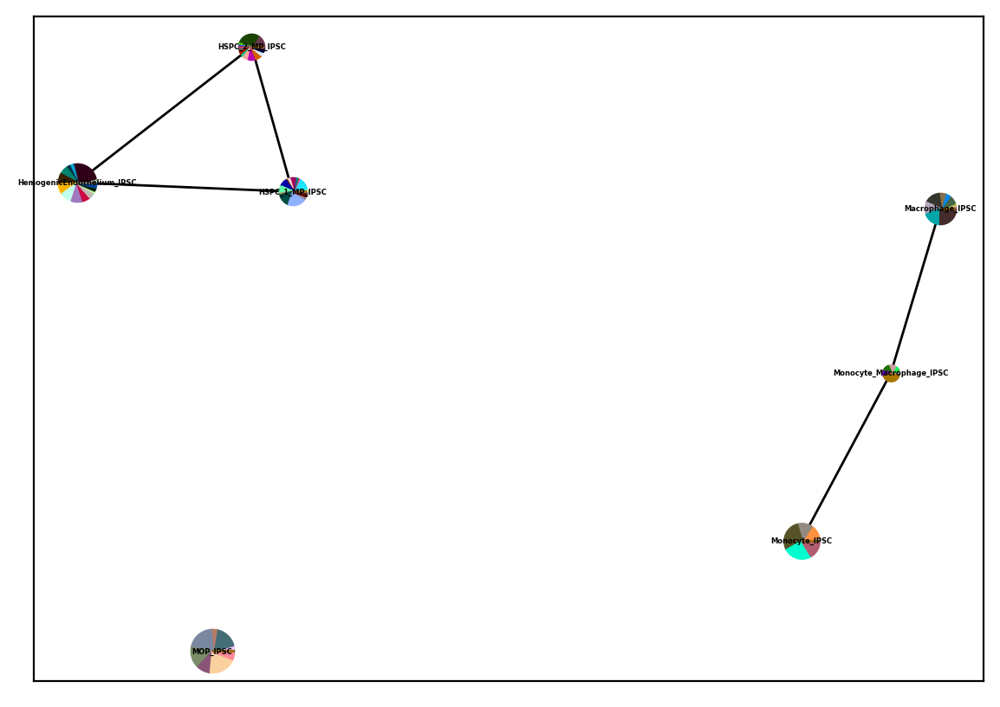

In [154]:
sc.tl.paga(adata, groups='predicted', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
#sc.pl.paga(adata, threshold=0.2, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')
sc.pl.paga(adata, threshold=0.5, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


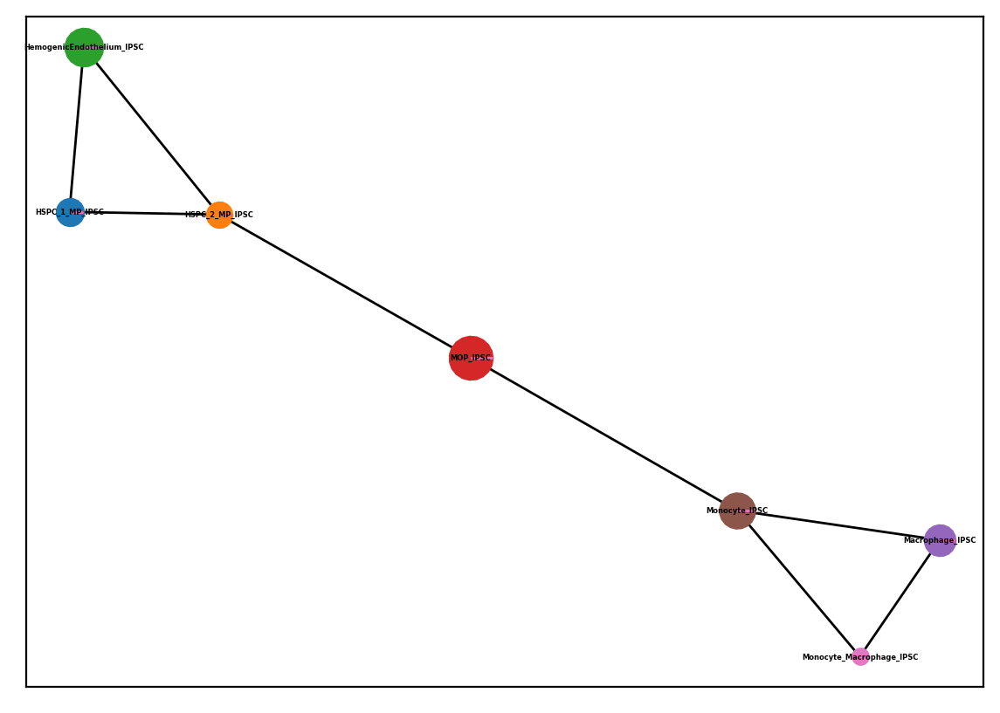

In [184]:
sc.tl.paga(adata, groups='predicted', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
sc.pl.paga(adata, threshold=0.41, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono')

In [185]:
sc.tl.draw_graph(adata, init_pos='paga')
#sc.tl.draw_graph(adata, random_state =None,layout='lgl',init_pos='paga')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:01:23)


In [223]:
cells = adata.obs['predicted'].cat.categories
embed = 'X_draw_graph_fa'
pos = []
for i in cells:
    tmp = adata[adata.obs['predicted'].isin([i])]
    tmp_emded = tmp.obsm[embed]
    # get centroids
    x = [p[0] for p in tmp_emded]
    y = [p[1] for p in tmp_emded]
    centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
    pos.append(centroid)
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)

In [224]:
list(adata.obs['predicted'].unique())

['HSPC_2_MP_IPSC',
 'HemogenicEndothelium_IPSC',
 'HSPC_1_MP_IPSC',
 'MOP_IPSC',
 'Monocyte_IPSC',
 'Macrophage_IPSC',
 'Monocyte_Macrophage_IPSC']

<AxesSubplot:xlabel='FA1', ylabel='FA2'>

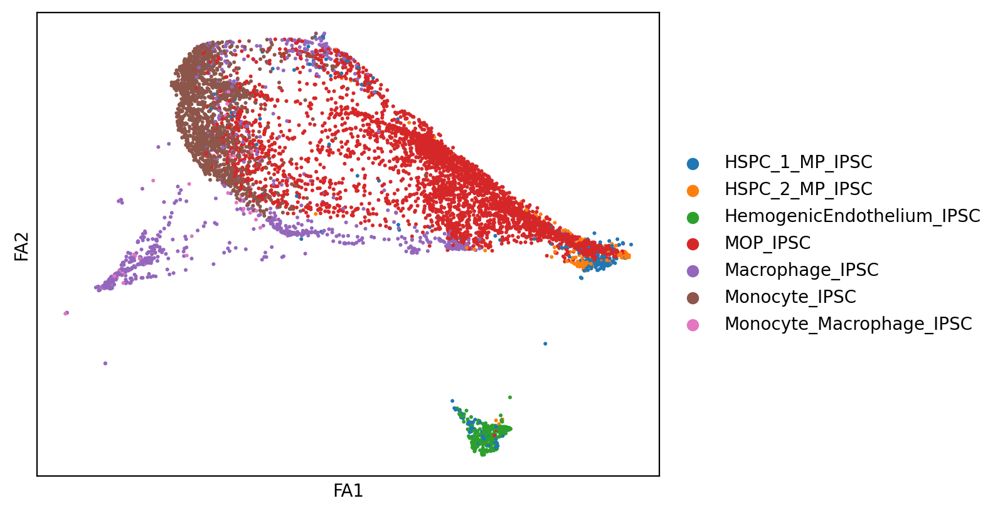

In [222]:
sc.pl.draw_graph(adata, color = 'predicted' ,show=False,title="") #title=i

In [225]:
adata.obs['corr_concat'] = adata.obs['predicted'].copy() 
adata.obs['cell.labels'] = adata.obs['predicted'].copy() 

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'corr_concat_num' as categorical


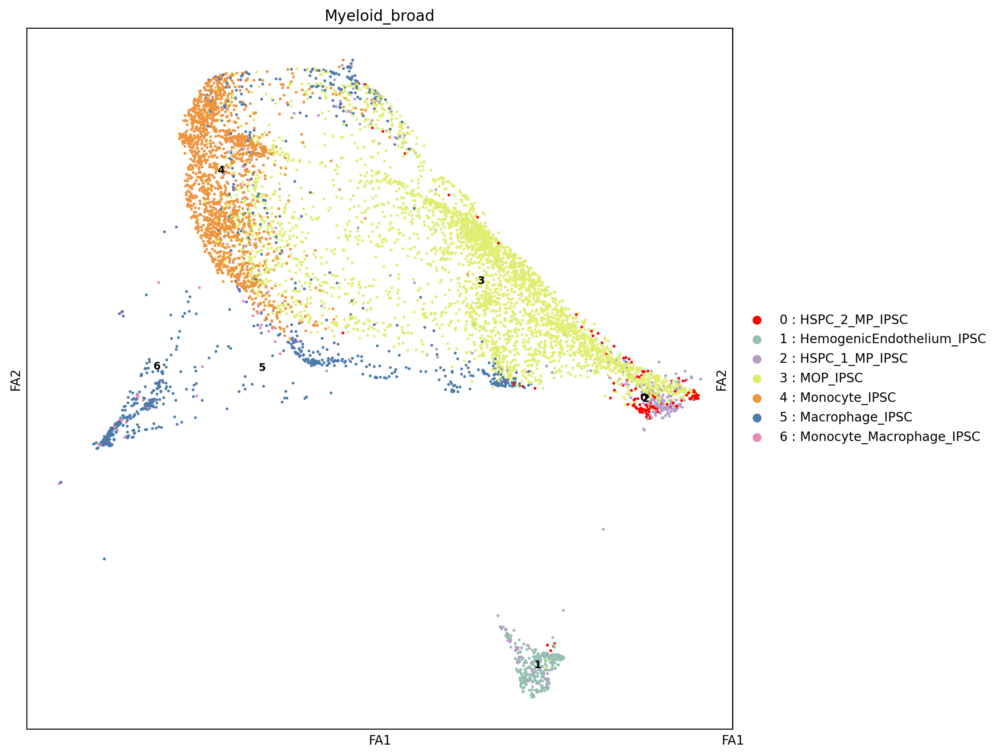

In [227]:
var = "corr_concat"
#Create color dictionary
cells =  (list(adata.obs['corr_concat'][adata.obs['tissue'].isin(['IPSC'])].unique()))
col = list(range(0, len(adata.obs[var].unique())))
#col = adata.uns['cell.labels_colors']
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

col_pal = ['#ff0000',    '#94BFB1',    '#B49EC8',    '#E0EE70',    '#EE943E',    '#4C7BAB',    '#E78AB8',    '#AFBFCC',    '#FF993F',    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
p3 = sc.pl.draw_graph(adata, color = "num",legend_loc="on data",size=20,legend_fontsize='small',ax=ax1,show=False,title="Myeloid_broad", palette= col_pal) #title=i

#fig.savefig('./'+var+"_just_IPSC_overall_num.pdf",bbox_inches='tight')

In [228]:
mapper = {
'HemogenicEndothelium_IPSC':'#eb2a0a',
'CMP': '#3B77AF',
'HSPC_1_MP_IPSC': '#ED8536',
 'HSPC_2_MP_IPSC': '#529B6C',
 'MOP_IPSC': '#C33932',
 'Macrophage_IPSC': '#9B50F3',
 'Monocyte_IPSC': '#D688C3',
 'Monocyte_Macrophage_IPSC': '#B7BC6D',
 'Pre_Macrophage_IPSC': '#5BBCCC',
 'Promonocyte_IPSC': '#B7CAE6'}

In [229]:
#adata = adata[~adata.obs['predicted'].isin(['HemogenicEndothelium_IPSC',])]

In [230]:
adata.obs[var].astype(str).map(mapper)

AATCGGTAGAGACGAA-13    #529B6C
AGATTGCGTAATCACC-13    #529B6C
AGTGTCAAGCAGCCTC-13    #eb2a0a
CACATTTCAAGAAAGG-13    #529B6C
CGAACATCAGGAATCG-13    #ED8536
                        ...   
TTCTCCTTCAACGCTA-19    #D688C3
TTCTCCTTCCAAGTAC-19    #9B50F3
TTGAACGAGCCAACAG-19    #C33932
TTGAACGTCACTTACT-19    #9B50F3
TTTACTGGTTATGCGT-19    #9B50F3
Name: corr_concat, Length: 6461, dtype: object

In [231]:
adata.obs[var].unique()

['HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'HSPC_1_MP_IPSC', 'MOP_IPSC', 'Monocyte_IPSC', 'Macrophage_IPSC', 'Monocyte_Macrophage_IPSC']
Categories (7, object): ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'MOP_IPSC', 'Macrophage_IPSC', 'Monocyte_IPSC', 'Monocyte_Macrophage_IPSC']

In [232]:
adata.uns['corr_concat_colors']

array(['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b',
       '#e377c2'], dtype='<U7')

In [52]:
adata.obs['corr_concat'].categories = ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'MOP_IPSC', 'Macrophage_IPSC', 'Monocyte_IPSC', 'Monocyte_Macrophage_IPSC']
adata.uns['corr_concat_colors'] = ['#ED8536','#529B6C','#eb2a0a','#C33932','#9B50F3','#D688C3','#B7BC6D']


adata.obs['predicted'].categories = ['HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC', 'HemogenicEndothelium_IPSC', 'MOP_IPSC', 'Macrophage_IPSC', 'Monocyte_IPSC', 'Monocyte_Macrophage_IPSC']
adata.uns['predicted_colors'] = ['#ED8536','#529B6C','#eb2a0a','#C33932','#9B50F3','#D688C3','#B7BC6D']

--> added 'pos', the PAGA positions (adata.uns['paga'])


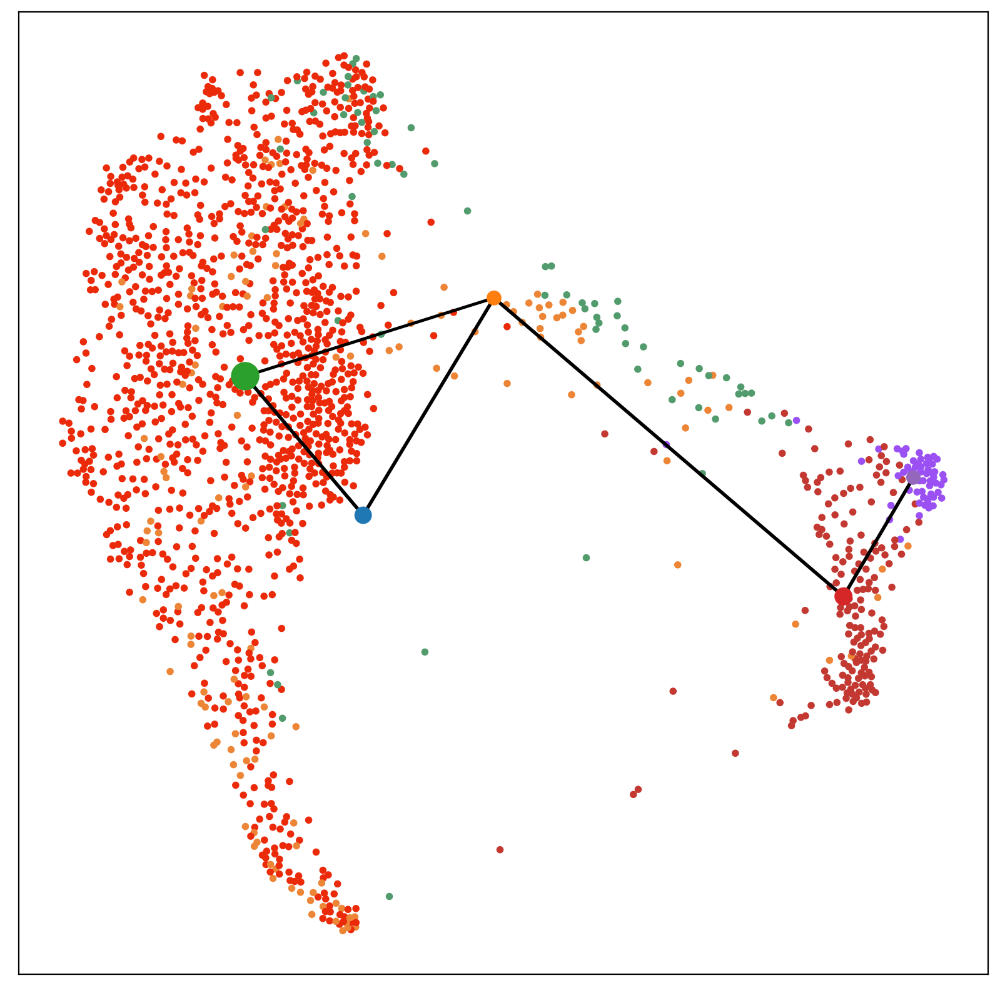

HSPC_1_MP_IPSC
HSPC_2_MP_IPSC
HemogenicEndothelium_IPSC
MOP_IPSC
Macrophage_IPSC


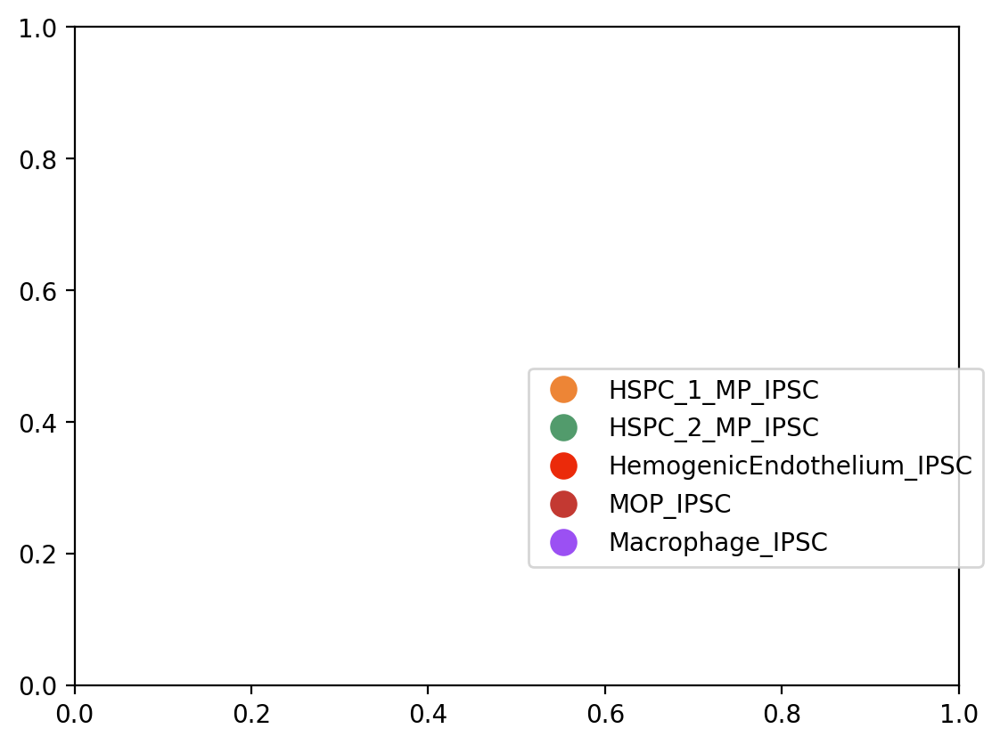

In [53]:
fig, ax = plt.subplots(1,figsize=(10,10))

var = 'predicted'
mapper = mapper #dict(zip(list(adata.obs[var].cat.categories),list(adata.uns[var+'_colors'])))
adata.obs['col'] = adata.obs[var].astype(str).map(mapper)
ax.scatter(adata.obsm['X_draw_graph_fa'][:,0], adata.obsm['X_draw_graph_fa'][:,1],c=adata.obs['col'],s=10)
#sc.pl.paga(adata, threshold=0, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono',ax=ax)
sc.pl.paga(adata, threshold=0.41 , title='',edge_width_scale=0.5,max_edge_width=2 ,pos = adata.uns['paga']['pos'],fontsize=0 ,fontoutline=0 ,  text_kwds={'alpha':0},labels = None,fontweight='bold',save = 'HE_paga',node_size_scale= 0.5,ax=ax)
# sc.pl.draw_graph(adata,color = var,ax=ax)
# ax.set_zorder(-1)
#Make legends

# box = ax.get_position()
# ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

import matplotlib.lines as mlines
legends = []
for legend in adata.obs[var].cat.categories:
    print(legend)
    legends.append(mlines.Line2D([], [], color=mapper[legend], marker='o', linestyle='None',
                          markersize=10, label=legend))
ax.grid(False)
plt.grid(False)
plt.legend(handles=legends,loc="upper left",bbox_to_anchor=(0.5, 0.5))
plt.savefig("./figures/legends_IPSC_mono_dependent_paga_overlay_v2.pdf")
fig.savefig("./figures/IPSC_mono_dependent_paga_overlay_v2.pdf", dpi=300,bbox_inches='tight')

In [235]:
adata.write('./IPSC_MAC_mono_dep.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'col' as categorical


In [ ]:
conda activate workhorse
cd /nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/
cellxgene launch /nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IPSC_MAC_no_mono.h5ad --port 5011 --host 0.0.0.0

In [97]:
new_annotations = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/IG_bm-cell-labels-ZXGIT772.csv',
                         comment='#',
                         dtype='category',
                         index_col=0)
adata.obs = adata.obs.join(new_annotations)

In [98]:
adata = adata[~adata.obs['keep'].isin(['keep'])]

computing density on 'umap'
--> added
    'umap_density_cell.labels', densities (adata.obs)
    'umap_density_cell.labels_params', parameter (adata.uns)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_embedding_density.py:170: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[density_covariate] = density_values
<ipython-input-236-f11b8c81d606>:23: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_cell.labels']


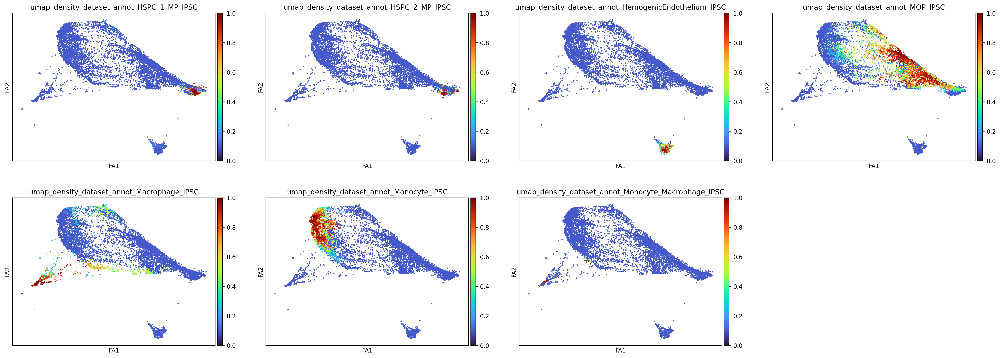

In [236]:
# cells = adata.obs['cell.labels'].cat.categories
# embed = 'X_draw_graph_fa'
# pos = []
# for i in cells:
#     tmp = adata[adata.obs['cell.labels'].isin([i])]
#     tmp_emded = tmp.obsm[embed]
#     # get centroids
#     x = [p[0] for p in tmp_emded]
#     y = [p[1] for p in tmp_emded]
#     centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
#     pos.append(centroid)
    
# adata_post_mono.uns['paga-back'] = adata_post_mono.uns['paga'].copy()
# adata_post_mono.uns['paga']['pos']= np.array(pos)


# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='cell.labels')
pos = []
map_scores = []
for i in adata.obs['cell.labels'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_cell.labels']
    adata.obs.loc[~adata.obs['cell.labels'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
    
#sc.pl.umap(adata,color = 'umap_density_dataset_annot',color_map = 'turbo')
#sc.pl.embedding_density(adata, groupby='dataset_annot',color_map = 'seismic')
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None)

--> added 'pos', the PAGA positions (adata.uns['paga'])


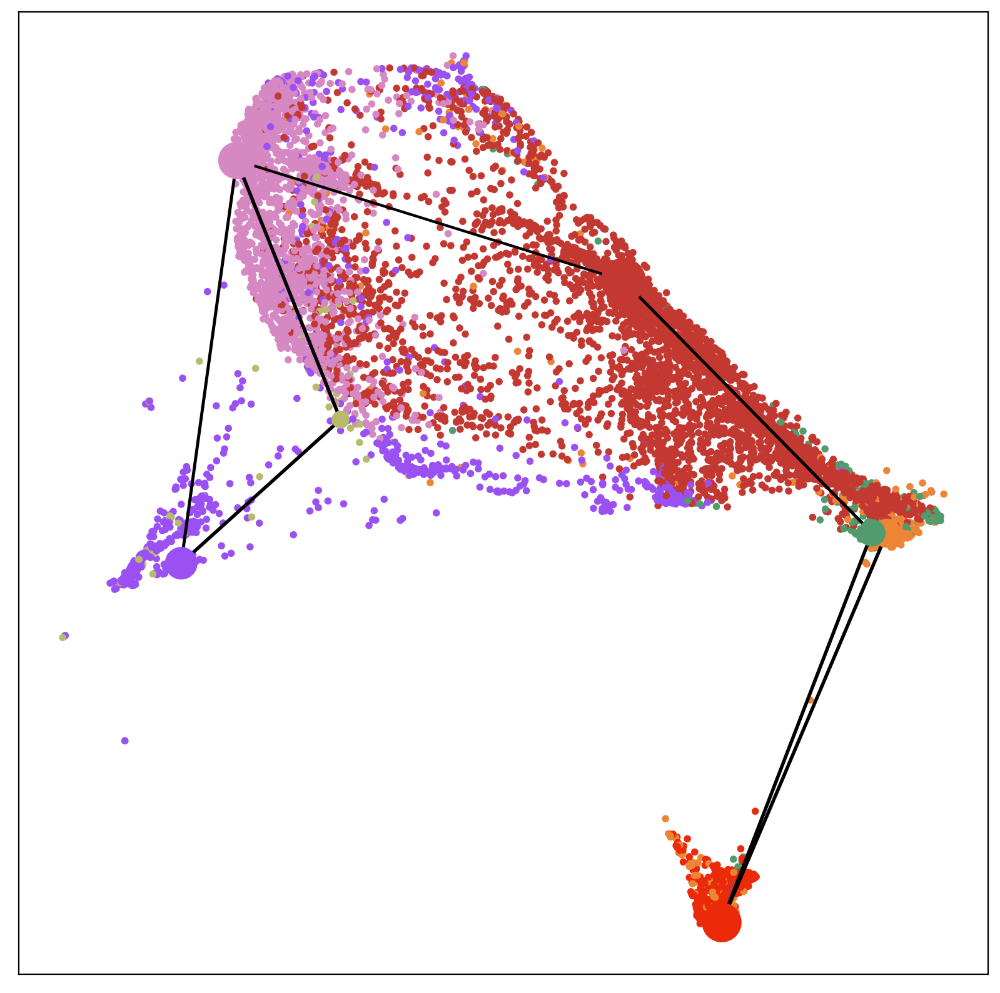

HSPC_1_MP_IPSC
HSPC_2_MP_IPSC
HemogenicEndothelium_IPSC
MOP_IPSC
Macrophage_IPSC
Monocyte_IPSC
Monocyte_Macrophage_IPSC


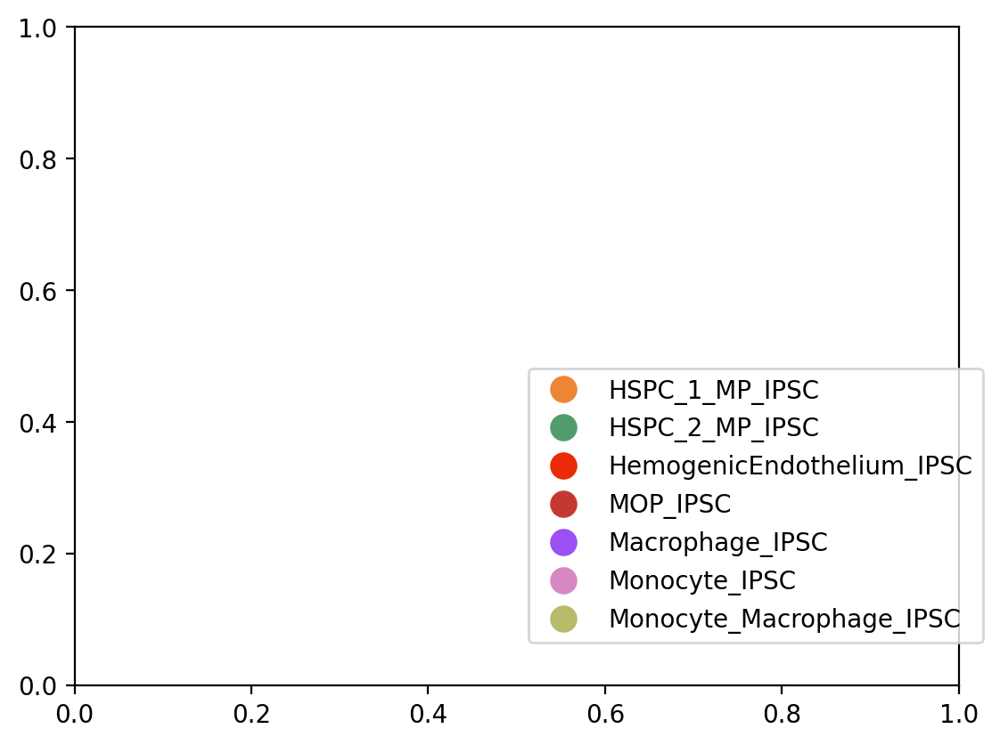

In [55]:
fig, ax = plt.subplots(1,figsize=(10,10))

var = 'corr_concat'
mapper = dict(zip(list(adata.obs[var].cat.categories),list(adata.uns[var+'_colors'])))
adata.obs['col'] = adata.obs[var].astype(str).map(mapper)
ax.scatter(adata.obsm['X_draw_graph_fa'][:,0], adata.obsm['X_draw_graph_fa'][:,1],c=adata.obs['col'],s=10)
#sc.pl.paga(adata, threshold=0, color = 'corr_concat' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 3,save='paga_pre-mono',ax=ax)
sc.pl.paga(adata, threshold=0.41 , title='',edge_width_scale=0.5,max_edge_width=2 ,pos = adata.uns['paga']['pos'],fontsize=0 ,fontoutline=0 ,  text_kwds={'alpha':0},labels = None,fontweight='bold',save = 'HE_paga',node_size_scale= 2,ax=ax)
# sc.pl.draw_graph(adata,color = var,ax=ax)
# ax.set_zorder(-1)
#Make legends

# box = ax.get_position()
# ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

import matplotlib.lines as mlines
legends = []
for legend in adata.obs[var].cat.categories:
    print(legend)
    legends.append(mlines.Line2D([], [], color=mapper[legend], marker='o', linestyle='None',
                          markersize=10, label=legend))
ax.grid(False)
plt.grid(False)
plt.legend(handles=legends,loc="upper left",bbox_to_anchor=(0.5, 0.5))
plt.savefig("./figures/legends_IPSC_mono_dep_above_D23_overlay_v2.pdf")
fig.savefig("./figures/IPSC_mono_dep_above_D23_paga_overlay_v2.pdf", dpi=300,bbox_inches='tight')

In [54]:
adata=sc.read('ipsc_mono_dependent.h5ad')

In [257]:
adata=sc.read('ipsc_mono_dependent.h5ad')

computing density on 'umap'
--> added
    'umap_density_SampleName', densities (adata.obs)
    'umap_density_SampleName_params', parameter (adata.uns)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_embedding_density.py:170: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[density_covariate] = density_values
<ipython-input-258-a753be963055>:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_SampleName']


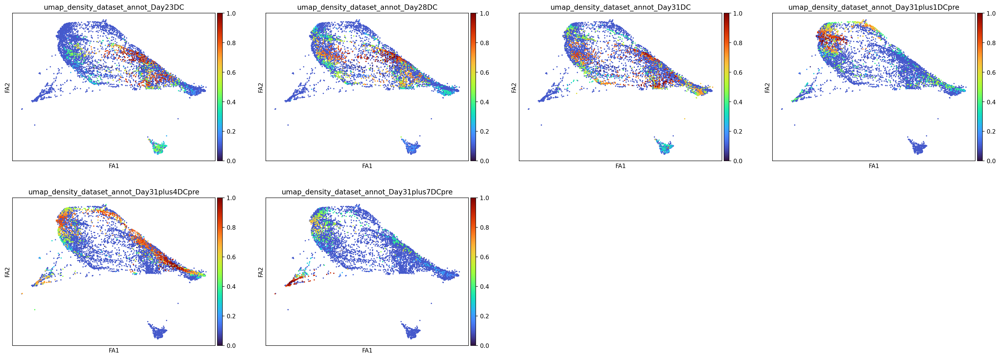

In [258]:
adata=sc.read('ipsc_mono_dependent.h5ad')
# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='SampleName')
pos = []
map_scores = []
for i in adata.obs['SampleName'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_SampleName']
    adata.obs.loc[~adata.obs['SampleName'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None,save = 'mono_dependent_sample_time.pdf')

In [36]:
concat = sc.read('./IPSC_lr_predicted_macrophages.h5ad')

In [41]:
adata = concat[:]

In [42]:
mono_inde =  ['Day04EB',
 'Day02EB',
 'Day05DC'
 'Day07DC',
 'Day09DC',
 'Day11DC',
 'Day14DC',
 'Day16DC',
 'Day18DC',
 'Day21DC',]

mono_dep = ['Day23DC',
 'Day28DC',
 'Day31DC',
 'Day31plus1DCpre',
 'Day31plus4DCpre',
 'Day31plus7DCpre',
 'Day25DC',]
                  

In [43]:
adata.obs['mono_dep'] = 'before_day21_mono_independent'
adata.obs.loc[adata.obs['SampleName'].isin(mono_inde),'mono_dep'] = 'before_day21_mono_independent'
adata.obs.loc[adata.obs['SampleName'].isin(mono_dep),'mono_dep'] = 'after_day_23_mono_dependent'

Trying to set attribute `.obs` of view, copying.
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/views.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  container[idx] = value


ranking genes


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'mono_dep' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:17)


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


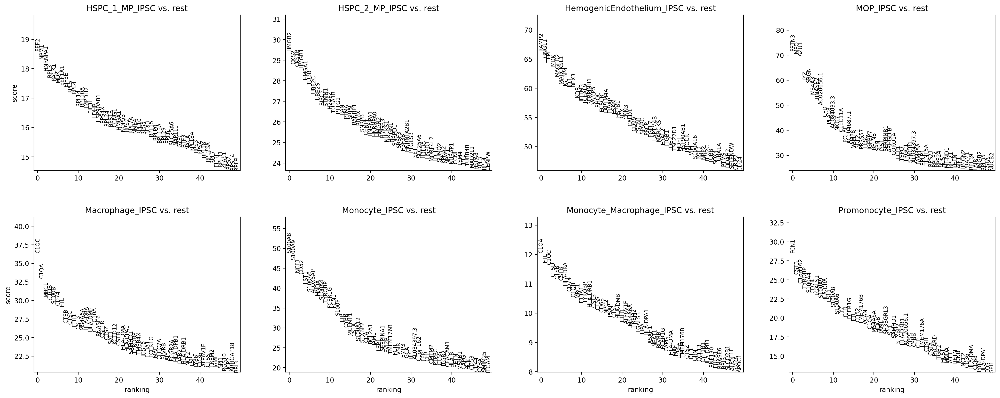

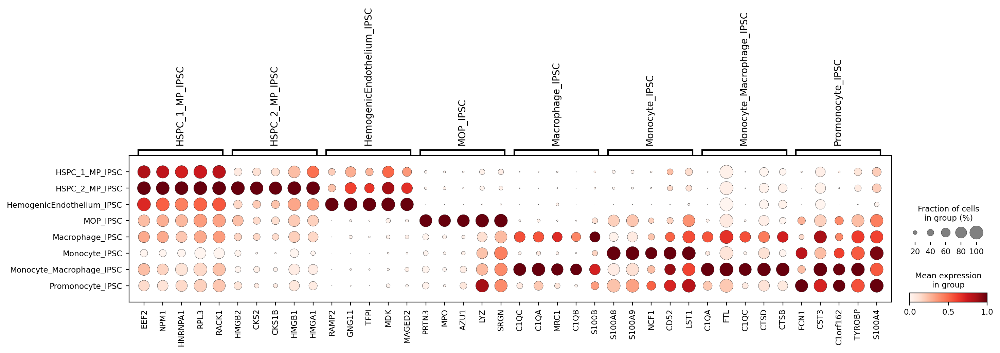

In [276]:
spot_var = 'predicted'
sc.tl.rank_genes_groups(adata, spot_var, method='wilcoxon',n_genes=500)
sc.pl.rank_genes_groups(adata, n_genes=50, sharey=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)
DE_name ="./DEGS_IPSC_MAC_Lin.csv"
DE.to_csv(DE_name)
degs = DE[:]
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})
concat = pd.concat([n,p,l],axis=1)
#remove mito genes from data
concat = concat[~concat["gene"].str.startswith("MT-")]
concat = concat[~concat["gene"].str.startswith("RP11-")]
concat["cluster"] = concat["cluster"].astype(str)
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(5, 'p_val')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}
data_temp = adata
markers = markers

In [44]:
adata.obs['cell_label_time'] = adata.obs['predicted'].astype(str) + '_' + adata.obs['mono_dep'].astype(str)
adata.obs['cell_label_time'] = adata.obs['cell_label_time'].astype('category')

<ipython-input-44-96398075a73e>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['cell_label_time'] = adata.obs['predicted'].astype(str) + '_' + adata.obs['mono_dep'].astype(str)


In [45]:
adata.obs['cell_label_time'] = adata.obs['cell_label_time'].astype('category')
adata.obs['cell_label_time'].cat.categories

Index(['HSPC_1_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_1_MP_IPSC_before_day21_mono_independent',
       'HSPC_2_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_2_MP_IPSC_before_day21_mono_independent',
       'HemogenicEndothelium_IPSC_after_day_23_mono_dependent',
       'HemogenicEndothelium_IPSC_before_day21_mono_independent',
       'MOP_IPSC_after_day_23_mono_dependent',
       'MOP_IPSC_before_day21_mono_independent',
       'Macrophage_IPSC_after_day_23_mono_dependent',
       'Macrophage_IPSC_before_day21_mono_independent',
       'Monocyte_IPSC_after_day_23_mono_dependent',
       'Monocyte_Macrophage_IPSC_after_day_23_mono_dependent',
       'Promonocyte_IPSC_after_day_23_mono_dependent',
       'Promonocyte_IPSC_before_day21_mono_independent'],
      dtype='object')

In [48]:
spot_var = 'predicted'
markers = { 'HemogenicEndothelium_IPSC': ['RAMP2', 'GNG11', 'TFPI', 'MDK', 'MAGED2'],
'HSPC_1_MP_IPSC': ['EEF2', 'NPM1', 'RACK1',"CD34",	"MLLT3",	"SPINK2",	],
 'HSPC_2_MP_IPSC': ["HOPX", 'CKS2', 'CKS1B', 'HMGB1', 'HMGA1'],
 'MOP_IPSC': ['PRTN3', 'MPO', 'AZU1', 'LYZ', 'SRGN'],
 'Promonocyte_IPSC': ['FCN1', 'CST3', 'C1orf162', 'TYROBP', 'S100A4'],
 'Monocyte_IPSC': ['CD14','S100A8', 'S100A9', 'NCF1', 'CD52', 'LST1'],
 'Monocyte_Macrophage_IPSC': ['C1QA', 'FTL', 'C1QC', 'CTSD', 'CTSB'],
 'Macrophage_IPSC': ['C1QC', 'C1QA', 'MRC1', 'C1QB', 'S100B'],}


adata.obs['predicted'].cat.reorder_categories([ 'HemogenicEndothelium_IPSC','HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC',
       'MOP_IPSC', 'Promonocyte_IPSC' ,'Monocyte_IPSC','Monocyte_Macrophage_IPSC','Macrophage_IPSC',])
predicted_order = [ 'HemogenicEndothelium_IPSC','HSPC_1_MP_IPSC', 'HSPC_2_MP_IPSC',
       'MOP_IPSC', 'Promonocyte_IPSC' ,'Monocyte_IPSC','Monocyte_Macrophage_IPSC','Macrophage_IPSC',]

adata.obs['cell_label_time'] = adata.obs['cell_label_time'].astype('category')
adata.obs['cell_label_time'].cat.reorder_categories( [
           'HemogenicEndothelium_IPSC_after_day_23_mono_dependent',
       'HemogenicEndothelium_IPSC_before_day21_mono_independent',
    'HSPC_1_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_1_MP_IPSC_before_day21_mono_independent',
       'HSPC_2_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_2_MP_IPSC_before_day21_mono_independent',
       'MOP_IPSC_after_day_23_mono_dependent',
       'MOP_IPSC_before_day21_mono_independent',
           'Promonocyte_IPSC_after_day_23_mono_dependent',
       'Promonocyte_IPSC_before_day21_mono_independent',
       'Monocyte_IPSC_after_day_23_mono_dependent',
       'Monocyte_Macrophage_IPSC_after_day_23_mono_dependent',
       'Macrophage_IPSC_after_day_23_mono_dependent',
       'Macrophage_IPSC_before_day21_mono_independent',
])
cell_labels_time_order =  [
           'HemogenicEndothelium_IPSC_after_day_23_mono_dependent',
       'HemogenicEndothelium_IPSC_before_day21_mono_independent',
    'HSPC_1_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_1_MP_IPSC_before_day21_mono_independent',
       'HSPC_2_MP_IPSC_after_day_23_mono_dependent',
       'HSPC_2_MP_IPSC_before_day21_mono_independent',
       'MOP_IPSC_after_day_23_mono_dependent',
       'MOP_IPSC_before_day21_mono_independent',
           'Promonocyte_IPSC_after_day_23_mono_dependent',
       'Promonocyte_IPSC_before_day21_mono_independent',
       'Monocyte_IPSC_after_day_23_mono_dependent',
       'Monocyte_Macrophage_IPSC_after_day_23_mono_dependent',
       'Macrophage_IPSC_after_day_23_mono_dependent',
       'Macrophage_IPSC_before_day21_mono_independent',
]

data_temp = adata

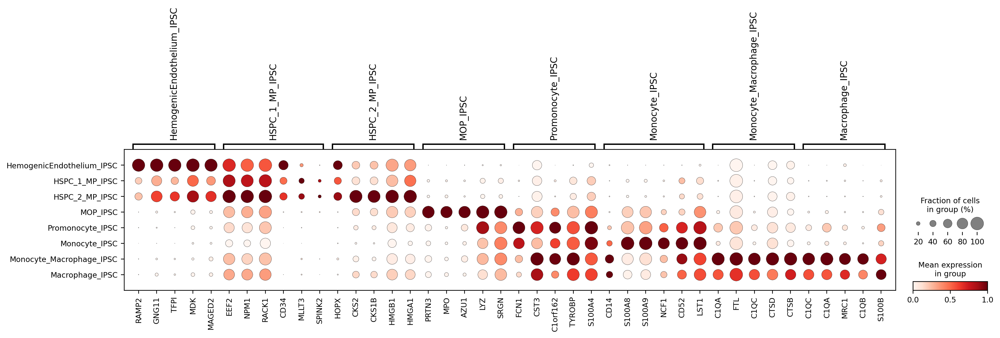

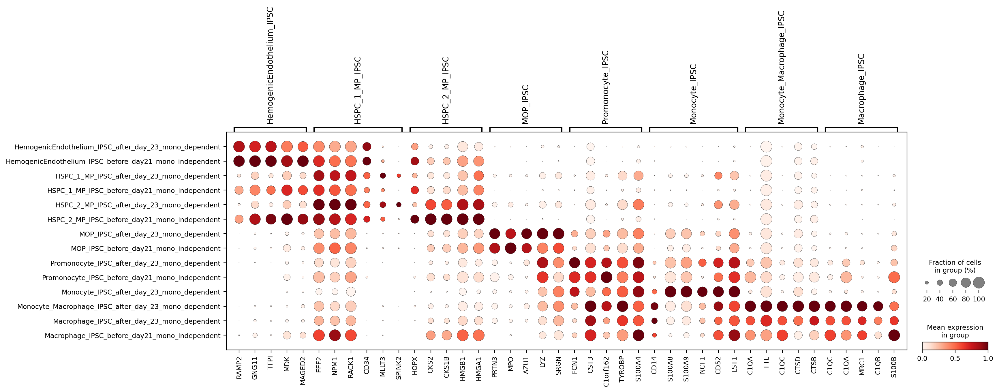

In [50]:
plt.rcdefaults() 
(sc.pl.dotplot(data_temp, var_names = markers, categories_order = predicted_order,groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_IPSC_mac_lin.pdf')) # title=i
(sc.pl.dotplot(data_temp, var_names = markers, categories_order =cell_labels_time_order,groupby='cell_label_time',dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_IPSC_mac_lin_by_pre_post_mono.pdf'))

In [311]:
adata_ipsc = adata[:]

In [312]:
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['corr_concat'].astype(str)
adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

Trying to set attribute `.obs` of view, copying.


In [313]:
# If we rename predicted
adata_ipsc.obs['predicted'] = adata_ipsc.obs['predicted'].map(dic)
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['predicted'].astype(str)
adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'] = adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'corr_concat'].astype(str) +  adata_ipsc.obs.loc[adata_ipsc.obs['tissue'].isin(['IPSC']),'SampleName'].astype(str)

In [314]:
plt.rcdefaults()
sc.pl.dotplot(adata,groupby='corr_concat',var_names=markers ,standard_scale='var',save = )

SyntaxError: invalid syntax (<ipython-input-314-bd98660de919>, line 2)

In [315]:
# Remove timepoint values where prediction < 1
adata_ipsc.obs['corr_concat'] = adata_ipsc.obs['corr_concat'].astype(str)
df = adata_ipsc.obs.groupby('corr_concat').apply(len)
adata_ipsc = adata_ipsc[adata_ipsc.obs['corr_concat'].isin(list(df.index[df>1]))]

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'corr_concat' as categorical


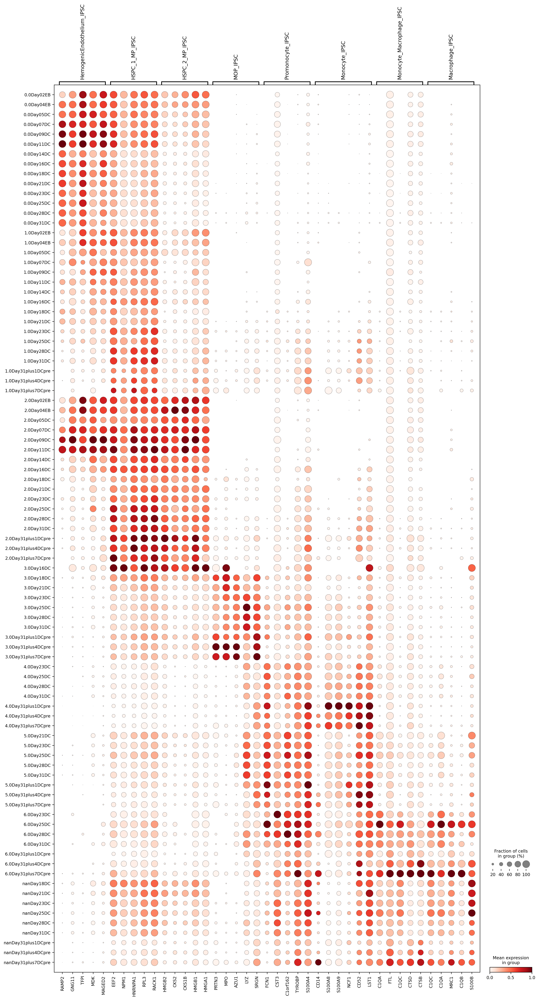

In [316]:
plt.rcdefaults()
sc.pl.dotplot(adata_ipsc,groupby='corr_concat',var_names=markers ,standard_scale='var',save = 'mono_exp_by_time')

# make trajectory for endoderm and mesoderm

In [ ]:
IPSC = sc.read('/')

In [8]:
concat = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/Process_IPSC_mac_data/V3_IPSC_LR_predicted_QC_outs.h5ad')

In [9]:
adata.obs.groupby(['CellTypeLR','SampleName']).apply(len)

AnnData object with n_obs × n_vars = 86820 × 22386
    obs: 'orig.ident', 'CellTypeLR', 'nCount_RNA', 'nFeature_RNA', 'DEMline', 'DBL_final', 'RAWdf', 'SOCline', 'percent.mt', 'SOClineRAW', 'SampleName', 'CellTypeP', 'DBLdetect', 'DBLscrub', 'DBLdemux', 'DBLsoc', 'DBL_nFINAL', 'S.Score', 'G2M.Score', 'Phase', 'CC.Difference', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.5', 'integrated_snn_res.0.8', 'integrated_snn_res.1', 'integrated_snn_res.3', 'integrated_snn_res.6', 'integrated_snn_res.10', 'seurat_clusters', 'tissue', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'V6_old_indexes', 'tissue_fetal_id', 'batch', 'n_counts', 'LR_assignment', 'restricted_LR_assignment'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable-1', 'intersect-1', 'means-1', 'dispersions-1', 'disp